# Restarting the notebook to test and train with the species in both tallo and NEON

In [2]:
# First we need to map between the satellite and the files

import pandas as pd
import os

data_dir = '../data/harvard/'
df = pd.read_csv(f'{data_dir}NEON_all.csv')
sat_files = os.listdir(f'{data_dir}sat_img/')
img_id_to_paths = {}
for f in sat_files:
    try:
        for s in os.listdir(f'{data_dir}sat_img/{f}/PSScene/'):
            if '.tif' in s and '_3B_AnalyticMS_SR_8b_clip.tif' in s: #'20221218_230845_90_2459_3B_AnalyticMS_SR_8b_clip.tif'
                img_id = s.replace('_3B_AnalyticMS_SR_8b_clip.tif', '')
                img_id_to_paths[img_id] = f'{data_dir}sat_img/{f}/PSScene/{s}'
    except:
        print(f)
# Now add to the df
paths = []
for img_id in df['image_ids'].values:
    paths.append(img_id_to_paths.get(img_id))
df['path'] = paths
df

,plotID,uid.x,namedLocation,date,tagEventID,domainID,siteID,plotID.1,subplotID,nestedSubplotID,...,species,genera,family,binary_label,x0,x1,y0,y1,image_ids,path
0,ABBY_001,b821b6f2-5047-4096-b5c6-5f14f0ea39ea,ABBY_001.basePlot.vst,2017-03-29T00:00:00Z,vst_ABBY_2016,D16,ABBY,ABBY_001,41.0,NaN,...,Pseudotsuga menziesii,Pseudotsuga,Pinaceae,1,45.769469,45.775719,-122.348588,-122.344084,20230224_180120_67_2459,../data/harvard/sat_img/45d41aed-d369-423f-940...
1,ABBY_002,0337c18f-d656-442d-95fe-248805d321ea,ABBY_002.basePlot.vst,2017-03-31T00:00:00Z,vst_ABBY_2016,D16,ABBY,ABBY_002,40.0,4.0,...,Sambucus sp.,Sambucus,Pinaceae,1,45.735916,45.742166,-122.311413,-122.306909,20230224_180120_67_2459,../data/harvard/sat_img/45d41aed-d369-423f-940...
2,ABBY_003,02f8b0f7-cf1a-40b9-a2a4-a8fca5115dd5,ABBY_003.basePlot.vst,2017-03-22T00:00:00Z,vst_ABBY_2016,D16,ABBY,ABBY_003,31.0,3.0,...,Pseudotsuga menziesii,Pseudotsuga,Pinaceae,1,45.758904,45.765154,-122.373344,-122.368840,20230224_180120_67_2459,../data/harvard/sat_img/45d41aed-d369-423f-940...
3,ABBY_004,57a1f855-89a8-4bf7-80c2-effc7a1f6b11,ABBY_004.basePlot.vst,2017-03-14T00:00:00Z,vst_ABBY_2016,D16,ABBY,ABBY_004,32.0,1.0,...,Pseudotsuga menziesii,Pseudotsuga,Pinaceae,1,45.765449,45.771699,-122.300995,-122.296490,20230224_180120_67_2459,../data/harvard/sat_img/45d41aed-d369-423f-940...
4,ABBY_005,061076b0-5619-49b8-a893-70099cbab6b4,ABBY_005.basePlot.vst,2017-03-23T00:00:00Z,vst_ABBY_2016,D16,ABBY,ABBY_005,40.0,1.0,...,Rubus spectabilis,Rubus,Rosaceae,1,45.767841,45.774091,-122.391658,-122.387154,20230224_180120_67_2459,../data/harvard/sat_img/45d41aed-d369-423f-940...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1328,YELL_058,ac4b0f2b-f319-441c-aad0-be003b127916,YELL_058.basePlot.vst,2019-09-09T00:00:00Z,vst_YELL_2019,D12,YELL,YELL_058,21.0,NaN,...,Pseudotsuga menziesii,Pseudotsuga,Pinaceae,1,44.951083,44.957333,-110.538363,-110.533858,20230216_175015_05_247f,../data/harvard/sat_img/678e44a3-d853-4ab0-ab2...
1329,YELL_059,caa4ee8a-9d03-4881-a5da-c2a0c59f604f,YELL_059.basePlot.vst,2019-09-24T00:00:00Z,vst_YELL_2019,D12,YELL,YELL_059,23.0,NaN,...,Pseudotsuga menziesii,Pseudotsuga,Pinaceae,1,44.949066,44.955316,-110.542326,-110.537821,20230216_175015_05_247f,../data/harvard/sat_img/678e44a3-d853-4ab0-ab2...
1330,YELL_060,91bf29d9-8213-43f7-bd71-a2d54e2d6bb0,YELL_060.basePlot.vst,2019-09-17T00:00:00Z,vst_YELL_2019,D12,YELL,YELL_060,41.0,1.0,...,Pseudotsuga menziesii,Pseudotsuga,Pinaceae,1,44.950886,44.957136,-110.545343,-110.540839,20230216_175015_05_247f,../data/harvard/sat_img/678e44a3-d853-4ab0-ab2...
1331,YELL_061,82bb0f3e-ad68-4b4f-b135-f01b31df9f56,YELL_061.basePlot.vst,2019-09-23T00:00:00Z,vst_YELL_2019,D12,YELL,YELL_061,41.0,NaN,...,Pseudotsuga menziesii,Pseudotsuga,Pinaceae,1,44.950291,44.956541,-110.542469,-110.537965,20230216_175015_05_247f,../data/harvard/sat_img/678e44a3-d853-4ab0-ab2...


In [3]:
img_id_to_paths

{'20230224_180120_67_2459': '../data/harvard/sat_img/45d41aed-d369-423f-940e-2e826491f44b/PSScene/20230224_180120_67_2459_3B_AnalyticMS_SR_8b_clip.tif',
 '20230207_165019_11_241a': '../data/harvard/sat_img/d4fbd0ea-96fb-4aa1-8922-a69ba70f1600/PSScene/20230207_165019_11_241a_3B_AnalyticMS_SR_8b_clip.tif',
 '20230212_151534_59_247d': '../data/harvard/sat_img/1f97caf7-f639-4793-bd22-74cae7eeb132/PSScene/20230212_151534_59_247d_3B_AnalyticMS_SR_8b_clip.tif',
 '20230207_150402_23_2448': '../data/harvard/sat_img/b4f7668b-19b1-48f4-a388-c905bc5803fc/PSScene/20230207_150402_23_2448_3B_AnalyticMS_SR_8b_clip.tif',
 '20230220_163134_04_241f': '../data/harvard/sat_img/26b26d8a-0e23-45b9-9079-62032e40f6d4/PSScene/20230220_163134_04_241f_3B_AnalyticMS_SR_8b_clip.tif',
 '20230203_154848_71_2459': '../data/harvard/sat_img/072222e1-82f8-487f-a88d-e43401ca59c2/PSScene/20230203_154848_71_2459_3B_AnalyticMS_SR_8b_clip.tif',
 '20230213_152347_35_24b6': '../data/harvard/sat_img/70ad5287-0e47-46bd-9cab-8e8be

# Plot some of the overview data

In [4]:
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
plt.rcParams['svg.fonttype'] = 'none'
from remseno import *
fig_dir = f'{data_dir}fig/'
n = 3
fig, axs = plt.subplots(len(set(df['species'].values))-1, n, figsize=(10, 30), facecolor='w', edgecolor='w')

axs = axs.ravel()
axi = 0
for species in set(df['species'].values):
    sub_df = df[df['species'] == species]
    ni = 0
    for img_path in sub_df['path'].values:
        if ni >= n:
            break
        if img_path != None:
            o = Image()
            o.load_image(image_path=img_path)
            o.name = species
            ax = o.plot_rbg(axs[axi])
            ax.set_yticks([])
            ax.set_xticks([])
            axi += 1
            ni += 1
plt.axis('off')
plt.gca().axes.get_yaxis().set_visible(False)
plt.gca().axes.get_xaxis().set_visible(False)

plt.savefig(f'{fig_dir}planetscope_data_overview.svg')
plt.show()


In [5]:
def get_features_for_tree(lat, lon, img, bands=[1, 2, 3, 4, 5, 6, 7, 8]):
    image_bands = []
    for band in bands: 
        image_bands.append(img.image.read(band)) 

    nitian, ndvi, sr, tvi, gi, gndvi, pri, osavi, tcari, redge, redge2, siredge, normg, schl, schlcar = get_all_planetscope(img.image)
    info_cols = image_bands + [nitian, ndvi, sr, tvi, gi, gndvi, pri, osavi, tcari, redge, redge2, siredge, normg, schl, schlcar]
    return get_values_for_location(o, lat, lon, info_cols)
    
def get_features_for_xy(y, x, img, bands=[1, 2, 3, 4, 5, 6, 7, 8]):
    image_bands = []
    for band in bands: 
        image_bands.append(img.image.read(band)) 

    nitian, ndvi, sr, tvi, gi, gndvi, pri, osavi, tcari, redge, redge2, siredge, normg, schl, schlcar = get_all_planetscope(img.image)
    info_cols = image_bands + [nitian, ndvi, sr, tvi, gi, gndvi, pri, osavi, tcari, redge, redge2, siredge, normg, schl, schlcar]
    return get_values_for_xy(y, x, info_cols)
    
def get_values_for_xy(x, y, bands_indices):
    # Gets all values, i.e. all bands, and all indicies
    # Now get all bands
    row = []
    for b in bands_indices:
        row.append(b[x, y])
    return row

# Read in the indicie DF and let's have a look at how this works for masking the current images..

In [6]:
len(set(df['image_ids'].values))

70

In [7]:
sub_df

NameError: name 'sub_df' is not defined

In [8]:
ind_df = pd.read_csv('../data/tallo/planetscope/indicie_average.csv')
bands = [1, 2, 3, 4, 5, 6, 7, 8]
masking_cols = [f'band_{i}' for i in bands] + ['nitian', 'ndvi', 'sr', 'tvi', 'gi', 'gndvi', 'pri', 'osavi', 'tcari', 'redge', 'redge2',
            'siredge', 'normg', 'schl', 'schlcar']

--------------------------------------------------------------------------------
left edge coord:	491580.0	
bottom edge coord:	5222997.0	
right edge coord:	492066.0	
top edge coord:	5223600.0	
dataset width:	162	
dataset height:	201	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32614	
data transform
	| 3.00, 0.00, 491580.00|
| 0.00,-3.00, 5223600.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
ALL NAN
--------------------------------------------------------------------------------
left edge coord:	457230.0	
bottom edge coord:	3102606.0	
right edge coord:	460785.0	
top edge coord:	3110418.0	
dataset width:	1185	
dataset height:	2604	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 457230.00|
| 0.00,-3.00, 3110418.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

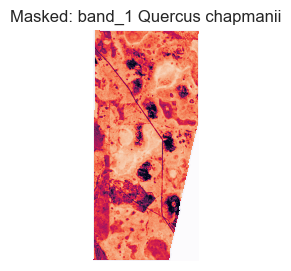

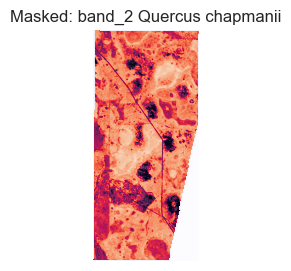

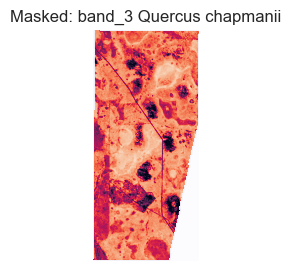

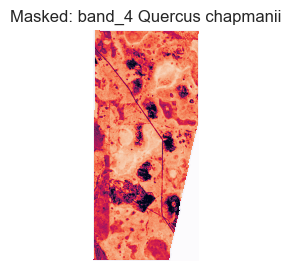

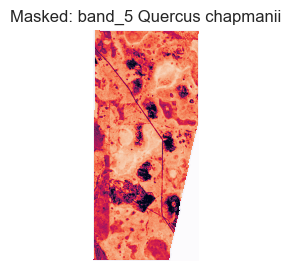

...

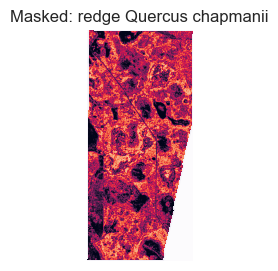

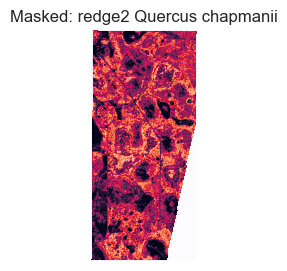

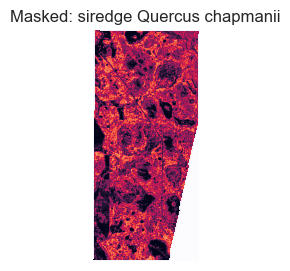

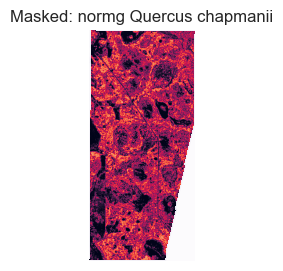

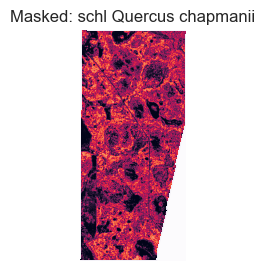

--------------------------------------------------------------------------------
left edge coord:	514413.0	
bottom edge coord:	3522777.0	
right edge coord:	517476.0	
top edge coord:	3530808.0	
dataset width:	1021	
dataset height:	2677	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32612	
data transform
	| 3.00, 0.00, 514413.00|
| 0.00,-3.00, 3530808.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


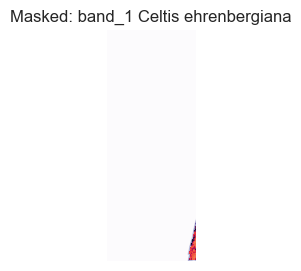

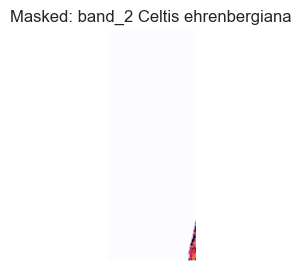

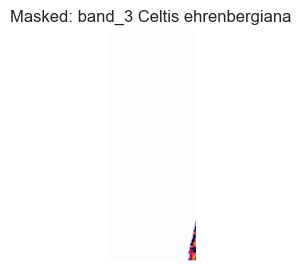

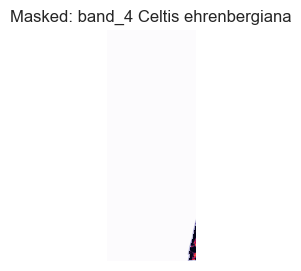

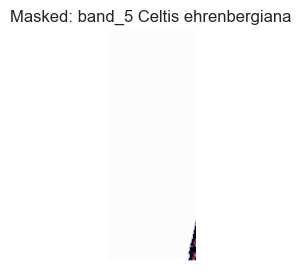

...

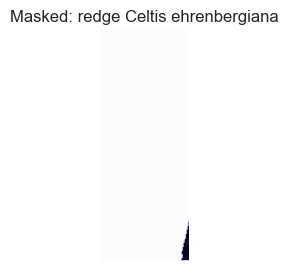

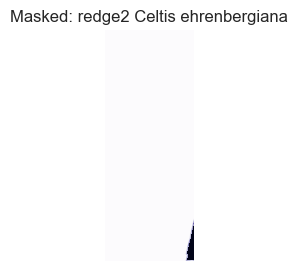

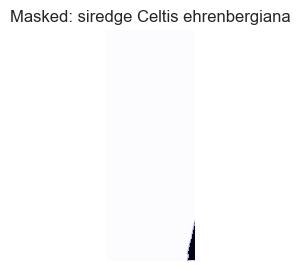

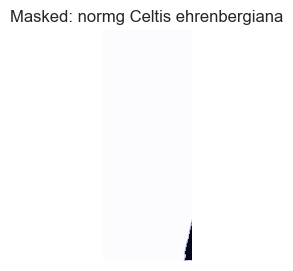

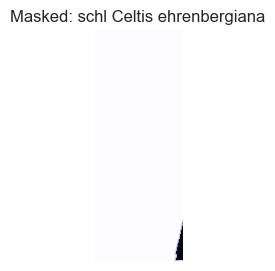

--------------------------------------------------------------------------------
left edge coord:	752997.0	
bottom edge coord:	4327188.0	
right edge coord:	753372.0	
top edge coord:	4327686.0	
dataset width:	125	
dataset height:	166	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 752997.00|
| 0.00,-3.00, 4327686.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
ALL NAN
--------------------------------------------------------------------------------
left edge coord:	521499.0	
bottom edge coord:	4517463.0	
right edge coord:	526875.0	
top edge coord:	4523964.0	
dataset width:	1792	
dataset height:	2167	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32613	
data transform
	| 3.00, 0.00, 521499.00|
| 0.00,-3.00, 4523964.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
ALL NAN
----------------------------------

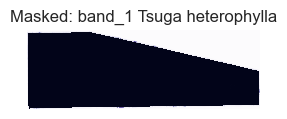

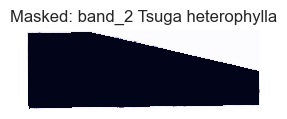

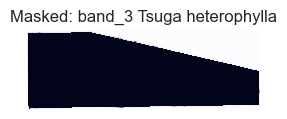

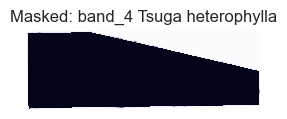

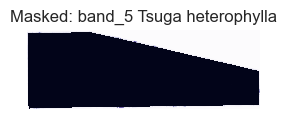

...

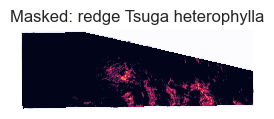

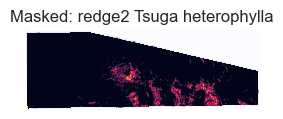

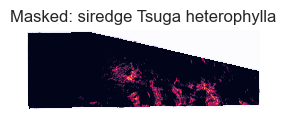

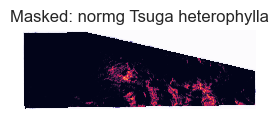

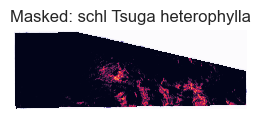

--------------------------------------------------------------------------------
left edge coord:	461217.0	
bottom edge coord:	3105102.0	
right edge coord:	462273.0	
top edge coord:	3105558.0	
dataset width:	352	
dataset height:	152	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 461217.00|
| 0.00,-3.00, 3105558.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


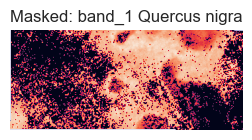

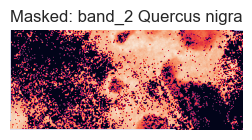

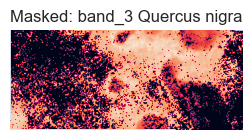

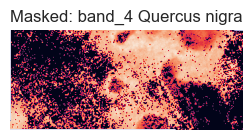

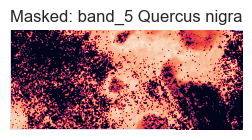

...

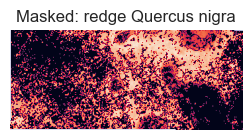

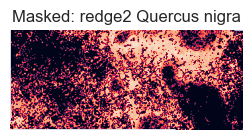

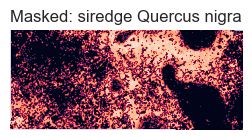

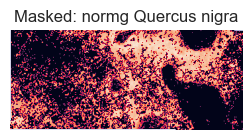

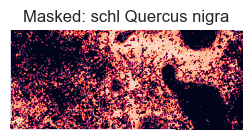

--------------------------------------------------------------------------------
left edge coord:	743646.0	
bottom edge coord:	3982101.0	
right edge coord:	751380.0	
top edge coord:	3985563.0	
dataset width:	2578	
dataset height:	1154	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 743646.00|
| 0.00,-3.00, 3985563.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


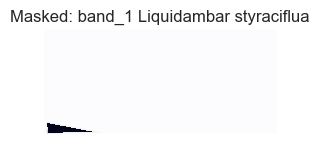

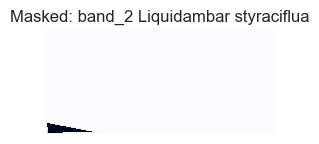

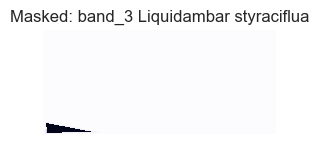

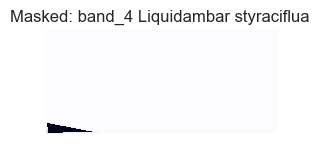

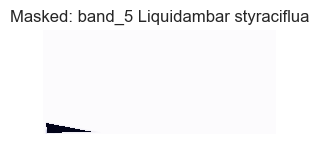

...

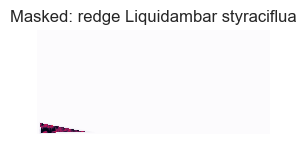

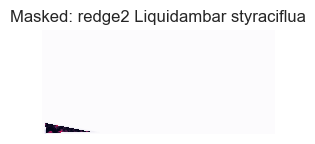

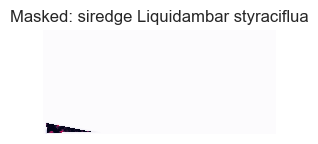

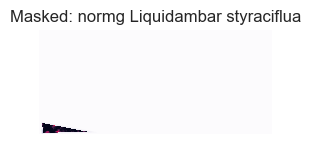

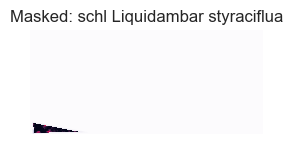

--------------------------------------------------------------------------------
left edge coord:	537594.0	
bottom edge coord:	4134600.0	
right edge coord:	545244.0	
top edge coord:	4142967.0	
dataset width:	2550	
dataset height:	2789	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 537594.00|
| 0.00,-3.00, 4142967.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


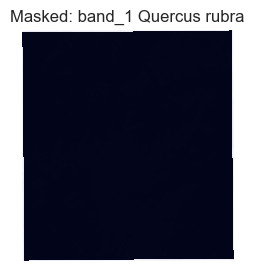

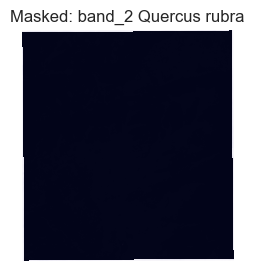

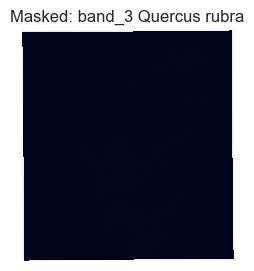

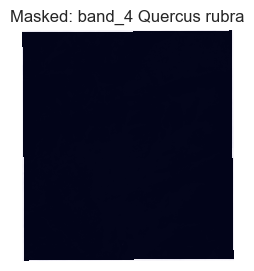

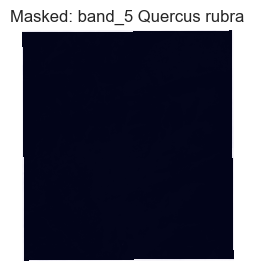

...

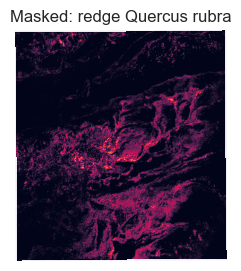

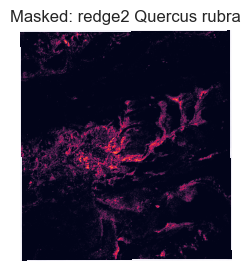

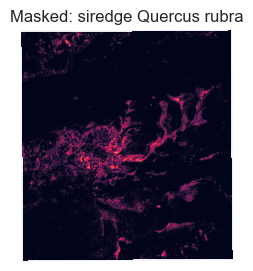

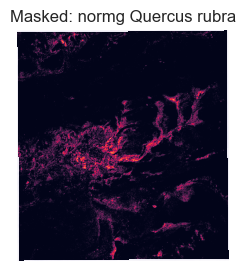

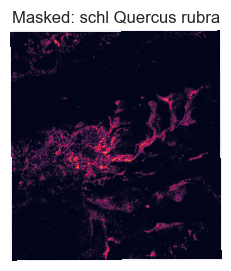

--------------------------------------------------------------------------------
left edge coord:	320598.0	
bottom edge coord:	4096518.0	
right edge coord:	321945.0	
top edge coord:	4097760.0	
dataset width:	449	
dataset height:	414	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32611	
data transform
	| 3.00, 0.00, 320598.00|
| 0.00,-3.00, 4097760.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
ALL NAN
--------------------------------------------------------------------------------
left edge coord:	303906.0	
bottom edge coord:	5122662.0	
right edge coord:	304800.0	
top edge coord:	5123439.0	
dataset width:	298	
dataset height:	259	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 303906.00|
| 0.00,-3.00, 5123439.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
ALL NAN
------------------------------------

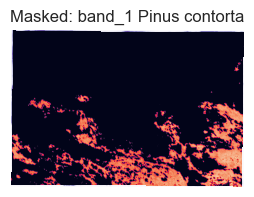

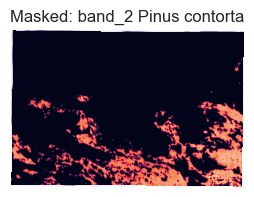

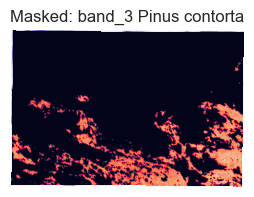

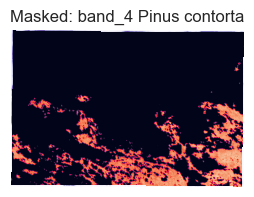

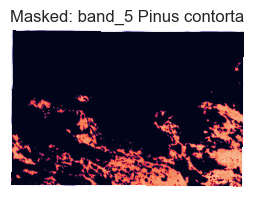

...

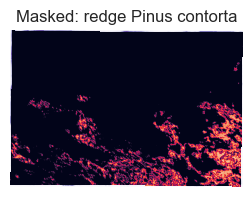

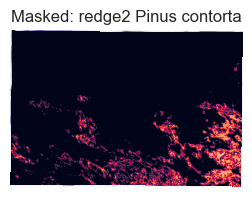

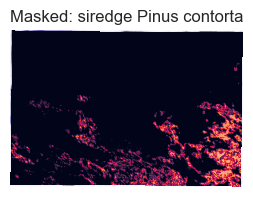

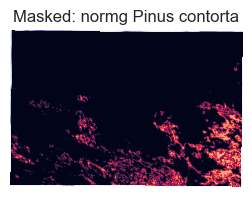

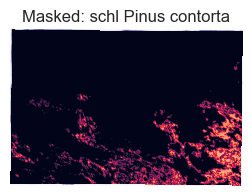

--------------------------------------------------------------------------------
left edge coord:	725430.0	
bottom edge coord:	4696971.0	
right edge coord:	730566.0	
top edge coord:	4704486.0	
dataset width:	1712	
dataset height:	2505	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32618	
data transform
	| 3.00, 0.00, 725430.00|
| 0.00,-3.00, 4704486.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


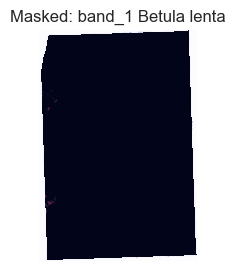

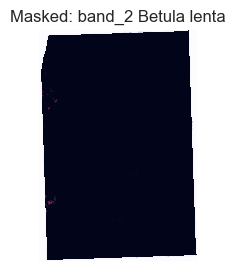

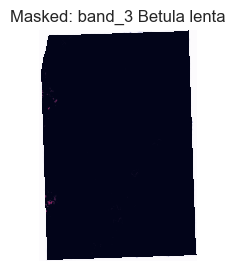

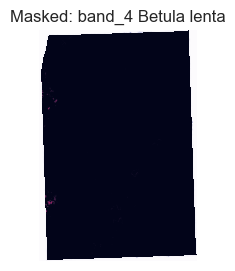

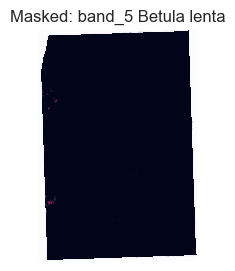

...

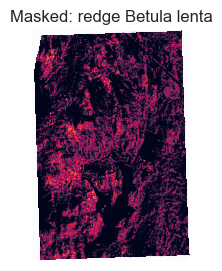

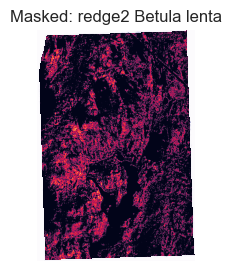

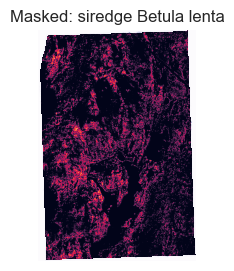

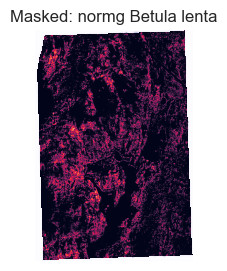

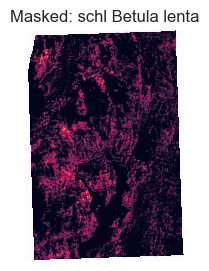

--------------------------------------------------------------------------------
left edge coord:	242748.0	
bottom edge coord:	4329894.0	
right edge coord:	244440.0	
top edge coord:	4330746.0	
dataset width:	564	
dataset height:	284	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32618	
data transform
	| 3.00, 0.00, 242748.00|
| 0.00,-3.00, 4330746.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
ALL NAN
--------------------------------------------------------------------------------
left edge coord:	297024.0	
bottom edge coord:	4099995.0	
right edge coord:	300573.0	
top edge coord:	4101555.0	
dataset width:	1183	
dataset height:	520	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32611	
data transform
	| 3.00, 0.00, 297024.00|
| 0.00,-3.00, 4101555.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


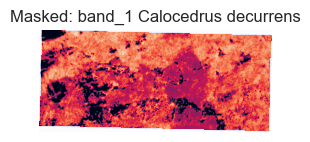

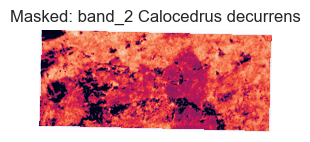

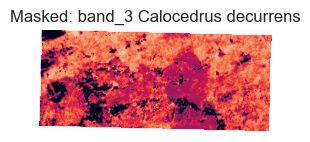

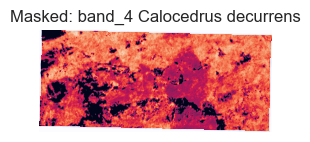

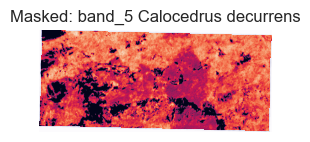

...

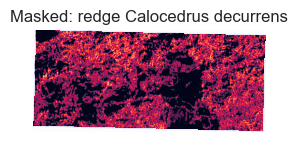

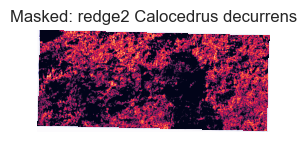

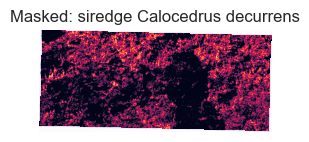

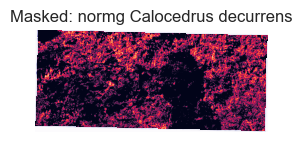

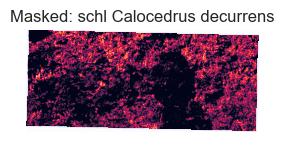

--------------------------------------------------------------------------------
left edge coord:	457497.0	
bottom edge coord:	3638574.0	
right edge coord:	463581.0	
top edge coord:	3648906.0	
dataset width:	2028	
dataset height:	3444	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 457497.00|
| 0.00,-3.00, 3648906.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


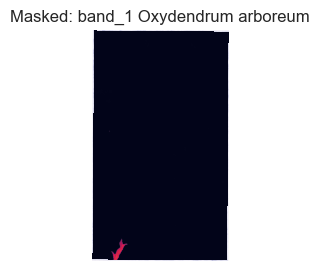

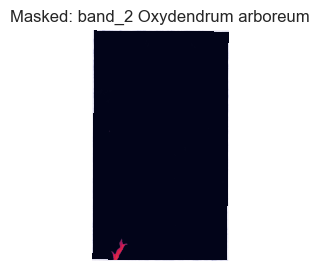

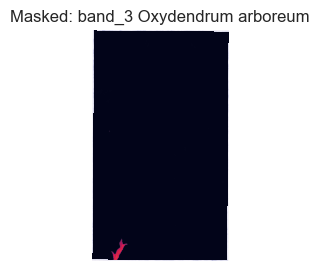

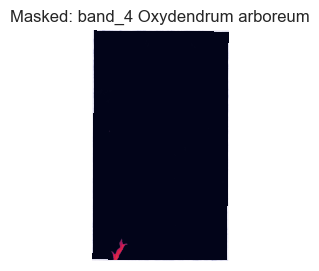

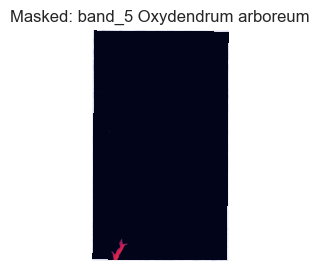

...

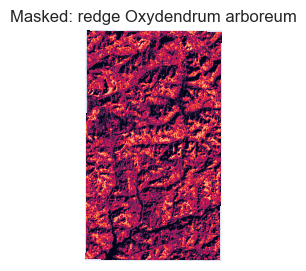

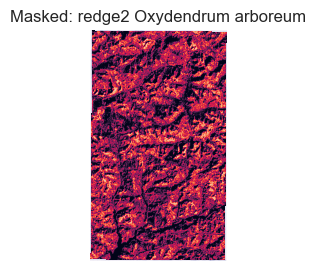

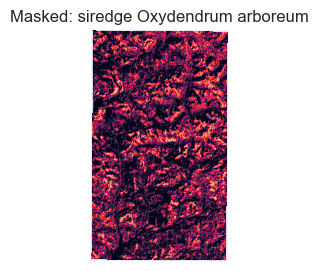

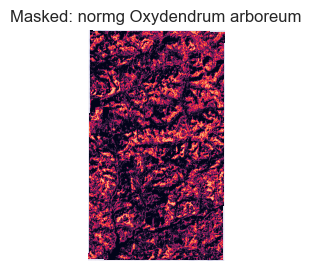

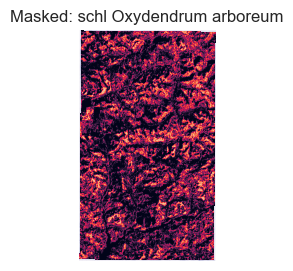

--------------------------------------------------------------------------------
left edge coord:	724902.0	
bottom edge coord:	5074335.0	
right edge coord:	729453.0	
top edge coord:	5079876.0	
dataset width:	1517	
dataset height:	1847	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32615	
data transform
	| 3.00, 0.00, 724902.00|
| 0.00,-3.00, 5079876.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


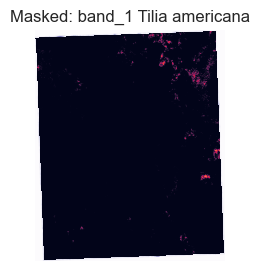

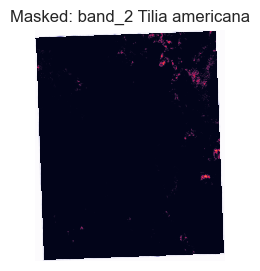

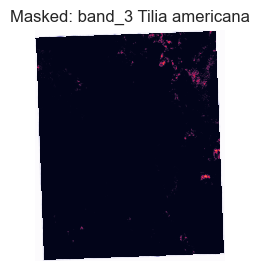

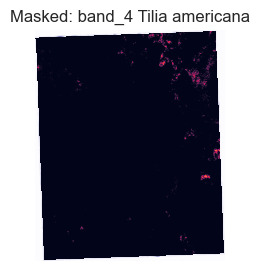

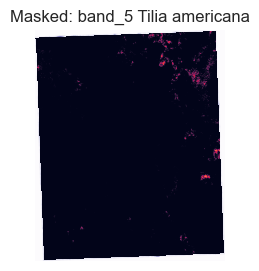

...

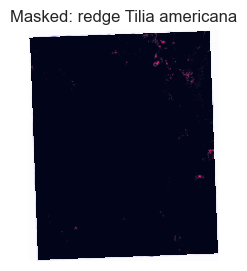

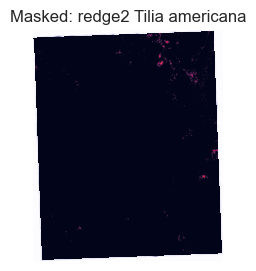

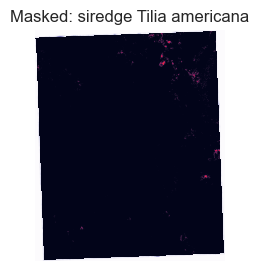

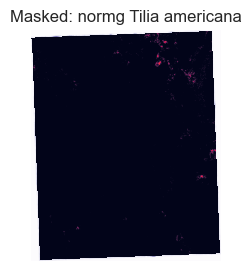

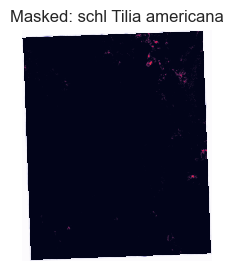

--------------------------------------------------------------------------------
left edge coord:	745929.0	
bottom edge coord:	4305849.0	
right edge coord:	749844.0	
top edge coord:	4310088.0	
dataset width:	1305	
dataset height:	1413	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 745929.00|
| 0.00,-3.00, 4310088.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


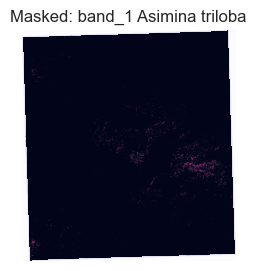

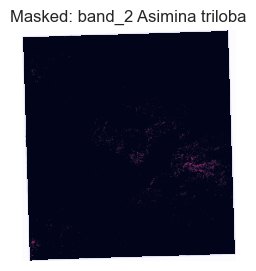

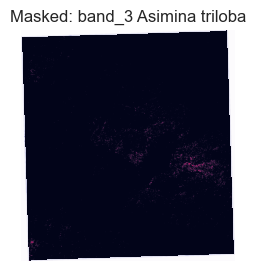

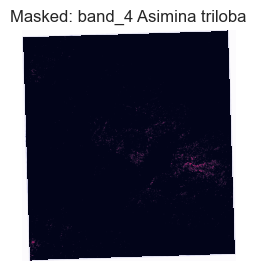

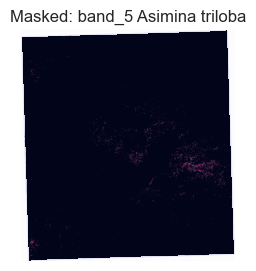

...

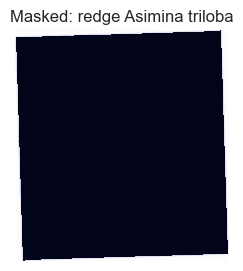

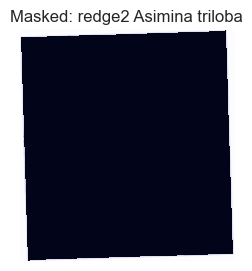

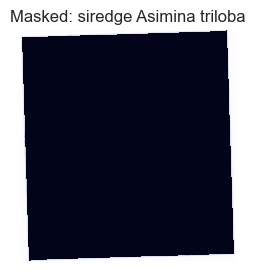

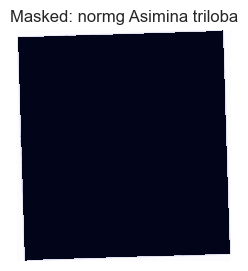

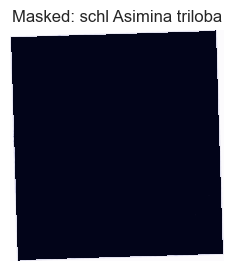

--------------------------------------------------------------------------------
left edge coord:	400767.0	
bottom edge coord:	3283620.0	
right edge coord:	408909.0	
top edge coord:	3288369.0	
dataset width:	2714	
dataset height:	1583	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 400767.00|
| 0.00,-3.00, 3288369.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


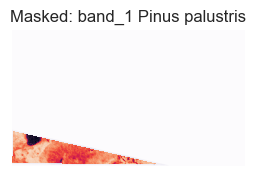

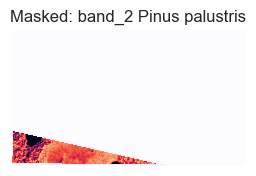

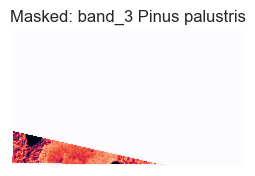

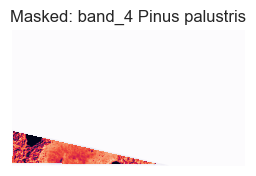

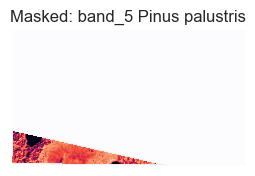

...

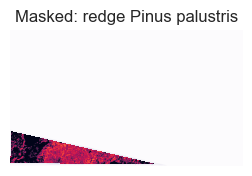

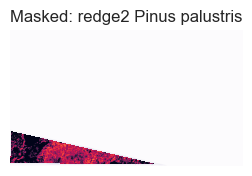

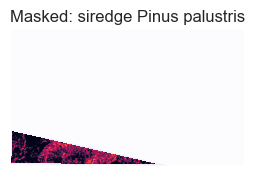

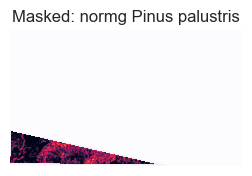

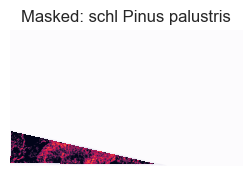

--------------------------------------------------------------------------------
left edge coord:	560481.0	
bottom edge coord:	7078782.0	
right edge coord:	562953.0	
top edge coord:	7090677.0	
dataset width:	824	
dataset height:	3965	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32606	
data transform
	| 3.00, 0.00, 560481.00|
| 0.00,-3.00, 7090677.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
ALL NAN
--------------------------------------------------------------------------------
left edge coord:	423069.0	
bottom edge coord:	3598392.0	
right edge coord:	424971.0	
top edge coord:	3600876.0	
dataset width:	634	
dataset height:	828	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 423069.00|
| 0.00,-3.00, 3600876.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


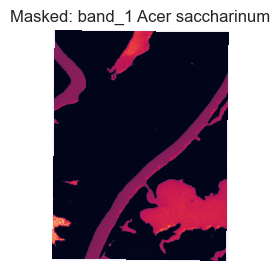

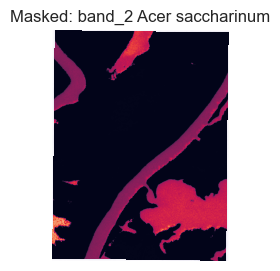

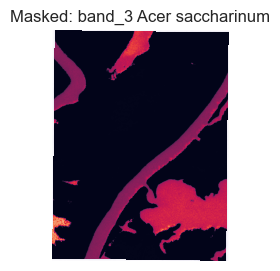

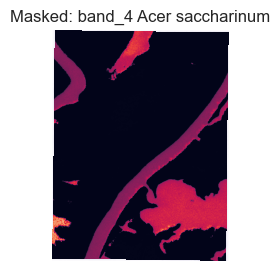

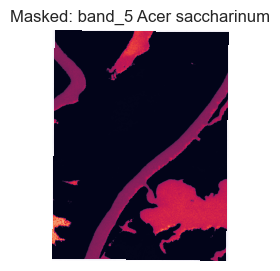

...

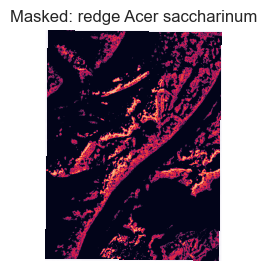

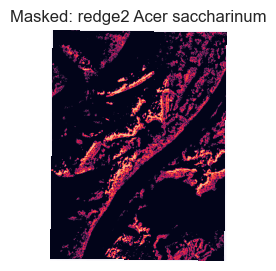

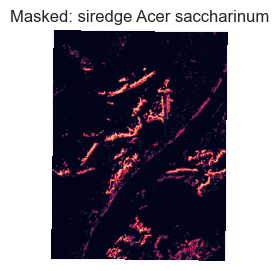

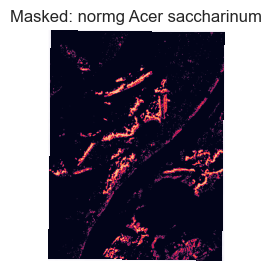

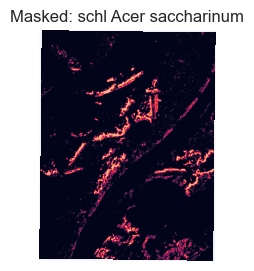

--------------------------------------------------------------------------------
left edge coord:	297261.0	
bottom edge coord:	5039433.0	
right edge coord:	300720.0	
top edge coord:	5042892.0	
dataset width:	1153	
dataset height:	1153	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 297261.00|
| 0.00,-3.00, 5042892.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


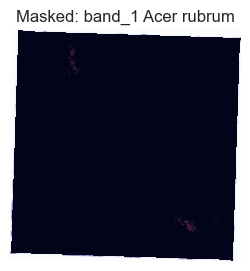

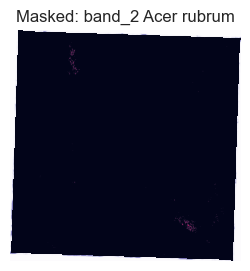

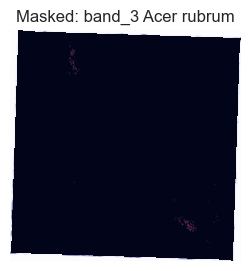

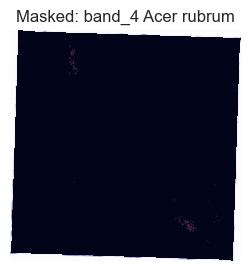

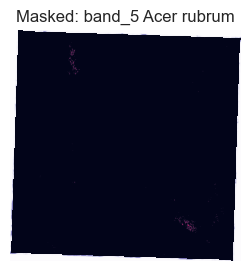

...

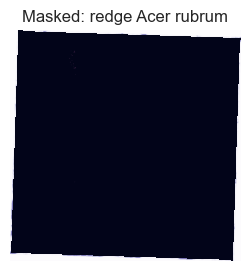

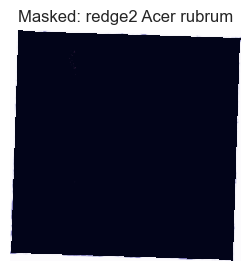

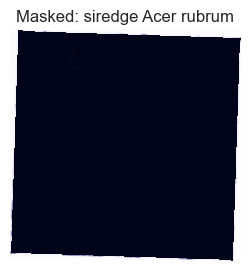

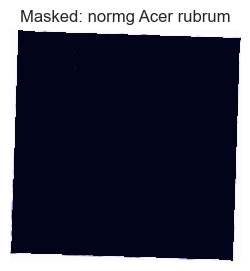

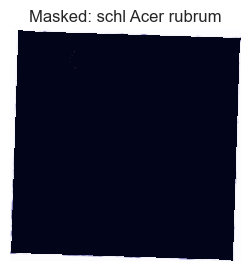

--------------------------------------------------------------------------------
left edge coord:	387570.0	
bottom edge coord:	7083672.0	
right edge coord:	391878.0	
top edge coord:	7087248.0	
dataset width:	1436	
dataset height:	1192	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32606	
data transform
	| 3.00, 0.00, 387570.00|
| 0.00,-3.00, 7087248.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
ALL NAN
--------------------------------------------------------------------------------
left edge coord:	368595.0	
bottom edge coord:	4444863.0	
right edge coord:	378291.0	
top edge coord:	4452483.0	
dataset width:	3232	
dataset height:	2540	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32612	
data transform
	| 3.00, 0.00, 368595.00|
| 0.00,-3.00, 4452483.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
ALL NAN
nan
----------------------------

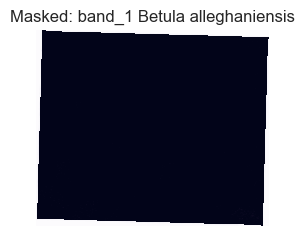

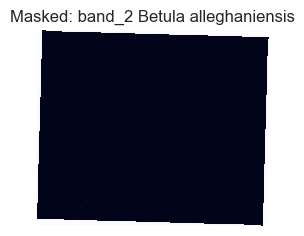

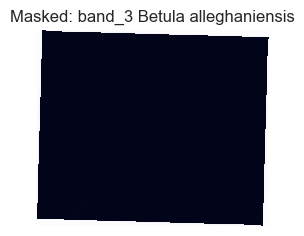

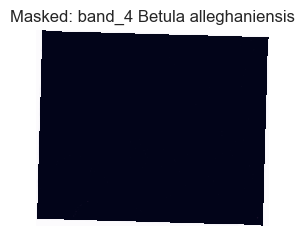

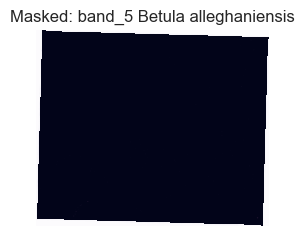

...

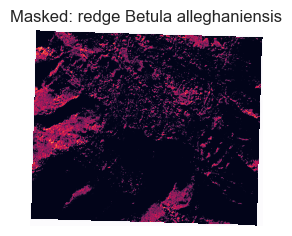

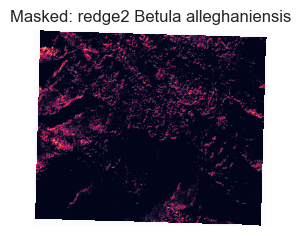

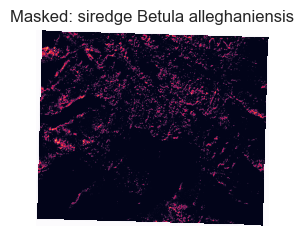

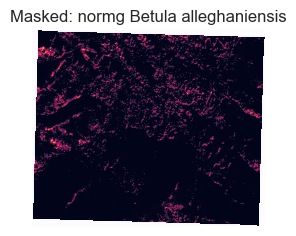

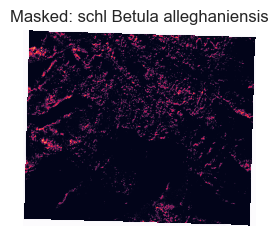

--------------------------------------------------------------------------------
left edge coord:	741096.0	
bottom edge coord:	3453864.0	
right edge coord:	741846.0	
top edge coord:	3454641.0	
dataset width:	250	
dataset height:	259	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 741096.00|
| 0.00,-3.00, 3454641.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


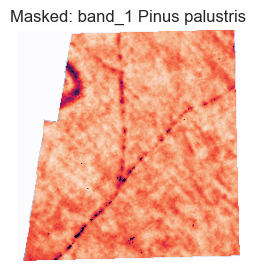

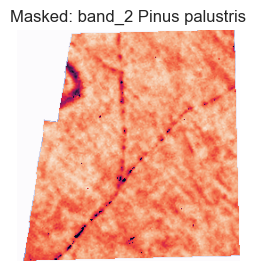

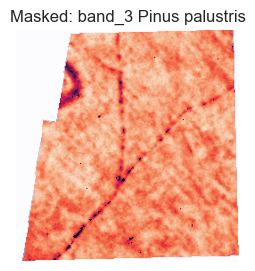

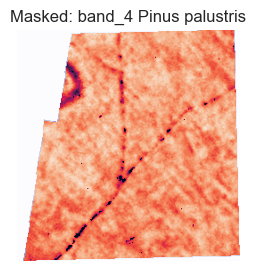

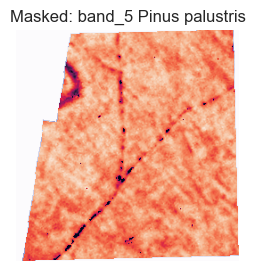

...

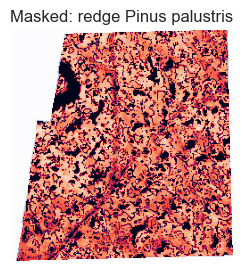

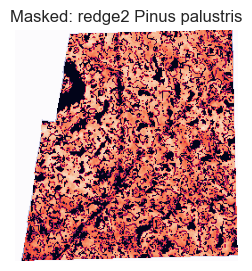

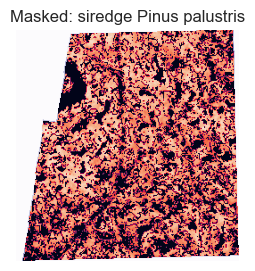

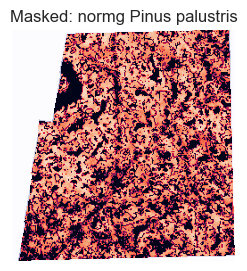

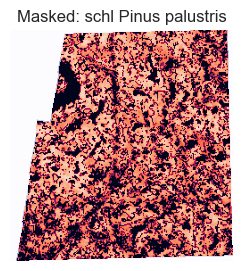

--------------------------------------------------------------------------------
left edge coord:	508491.0	
bottom edge coord:	3515208.0	
right edge coord:	511710.0	
top edge coord:	3519357.0	
dataset width:	1073	
dataset height:	1383	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32612	
data transform
	| 3.00, 0.00, 508491.00|
| 0.00,-3.00, 3519357.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


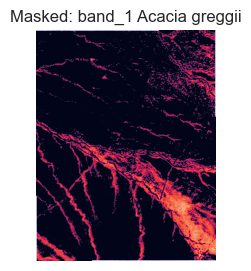

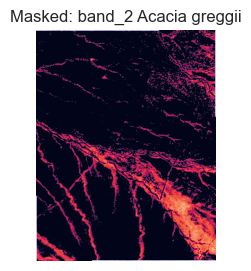

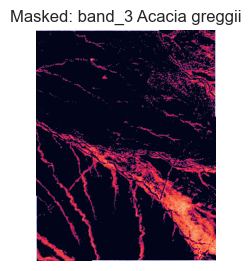

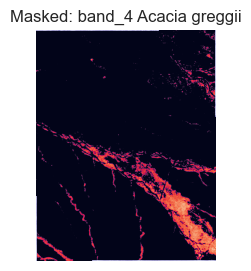

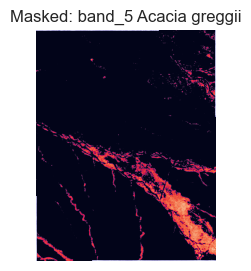

...

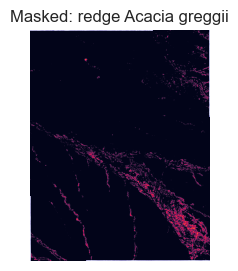

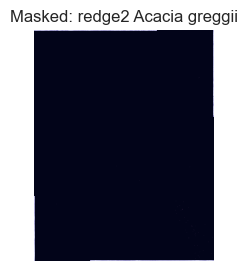

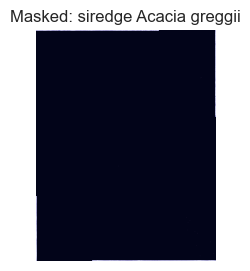

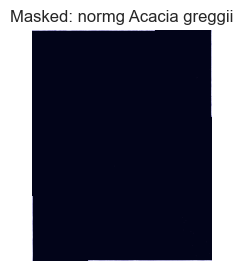

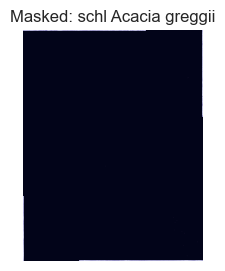

--------------------------------------------------------------------------------
left edge coord:	481314.0	
bottom edge coord:	5219280.0	
right edge coord:	483999.0	
top edge coord:	5222043.0	
dataset width:	895	
dataset height:	921	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32614	
data transform
	| 3.00, 0.00, 481314.00|
| 0.00,-3.00, 5222043.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
ALL NAN
--------------------------------------------------------------------------------
left edge coord:	474843.0	
bottom edge coord:	7229982.0	
right edge coord:	479196.0	
top edge coord:	7230354.0	
dataset width:	1451	
dataset height:	124	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32606	
data transform
	| 3.00, 0.00, 474843.00|
| 0.00,-3.00, 7230354.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
ALL NAN
-----------------------------------

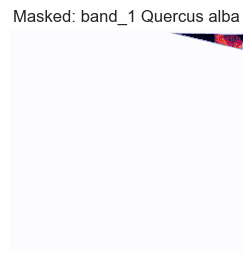

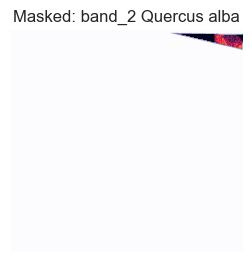

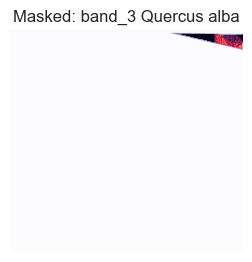

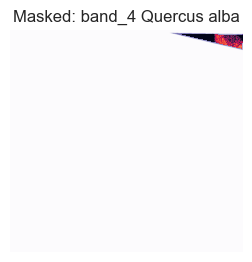

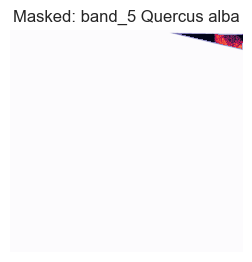

...

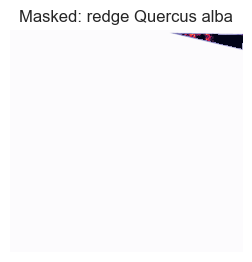

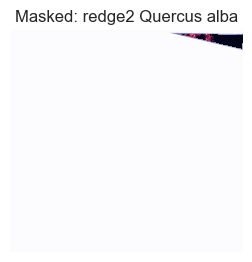

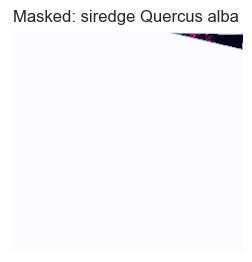

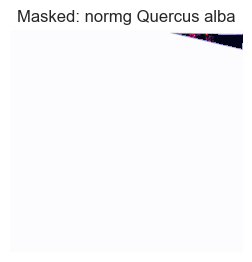

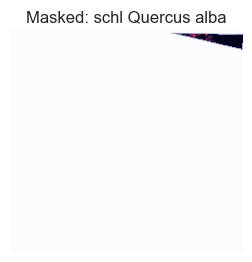

--------------------------------------------------------------------------------
left edge coord:	624402.0	
bottom edge coord:	3688617.0	
right edge coord:	633453.0	
top edge coord:	3698370.0	
dataset width:	3017	
dataset height:	3251	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32614	
data transform
	| 3.00, 0.00, 624402.00|
| 0.00,-3.00, 3698370.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


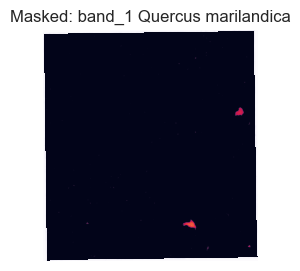

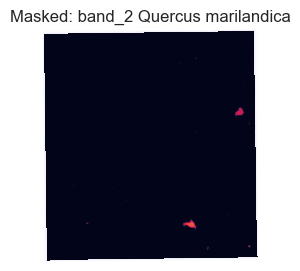

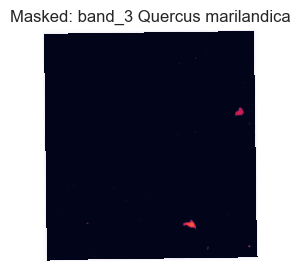

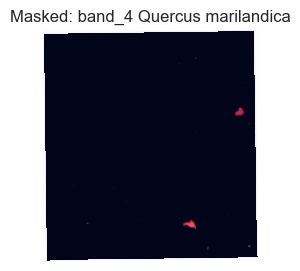

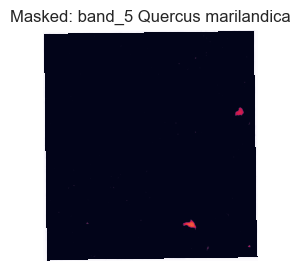

...

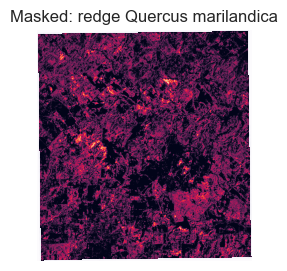

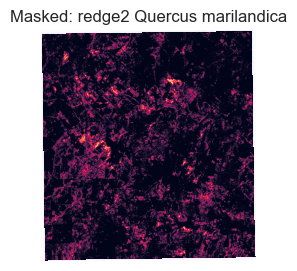

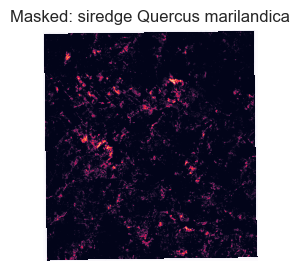

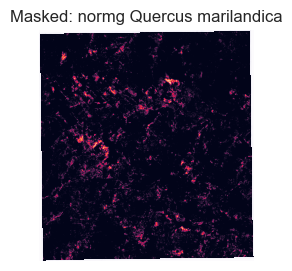

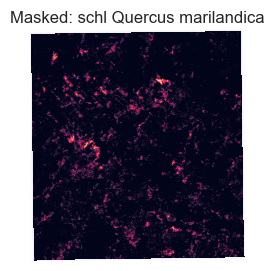

--------------------------------------------------------------------------------
left edge coord:	460401.0	
bottom edge coord:	3101655.0	
right edge coord:	461352.0	
top edge coord:	3103728.0	
dataset width:	317	
dataset height:	691	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 460401.00|
| 0.00,-3.00, 3103728.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


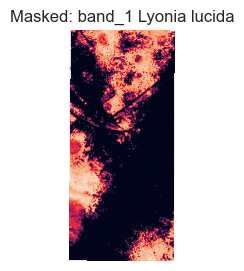

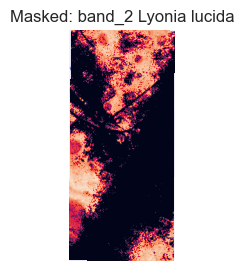

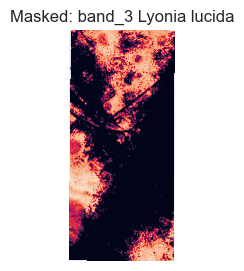

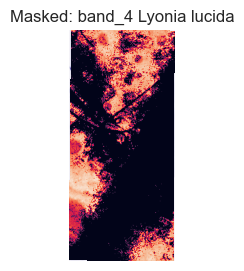

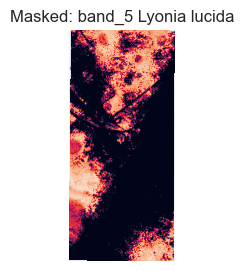

...

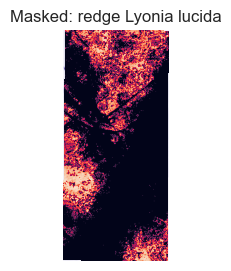

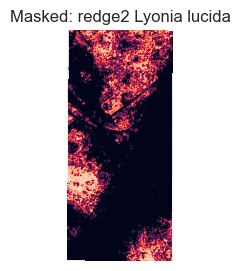

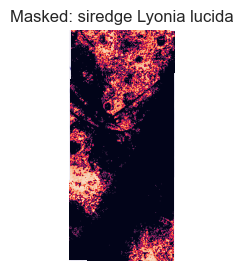

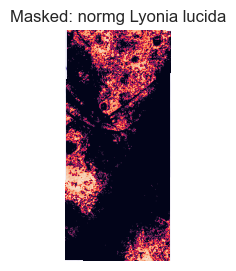

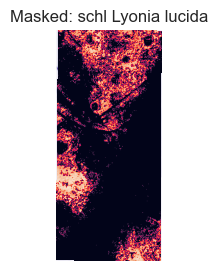

--------------------------------------------------------------------------------
left edge coord:	703962.0	
bottom edge coord:	1995051.0	
right edge coord:	704643.0	
top edge coord:	1995165.0	
dataset width:	227	
dataset height:	38	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32619	
data transform
	| 3.00, 0.00, 703962.00|
| 0.00,-3.00, 1995165.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


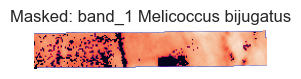

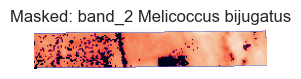

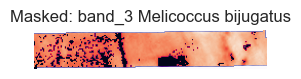

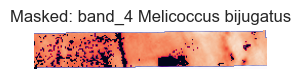

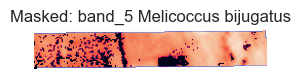

...

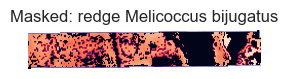

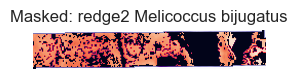

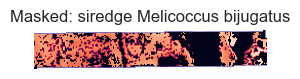

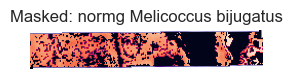

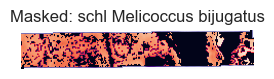

--------------------------------------------------------------------------------
left edge coord:	724062.0	
bottom edge coord:	4705722.0	
right edge coord:	725283.0	
top edge coord:	4706907.0	
dataset width:	407	
dataset height:	395	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32618	
data transform
	| 3.00, 0.00, 724062.00|
| 0.00,-3.00, 4706907.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


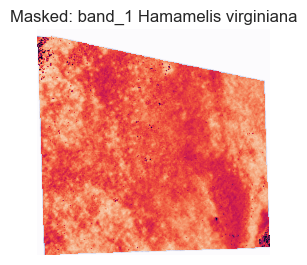

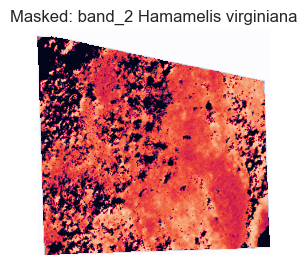

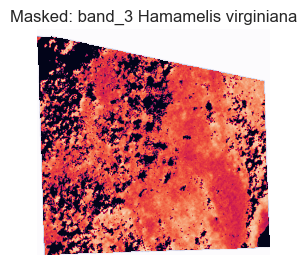

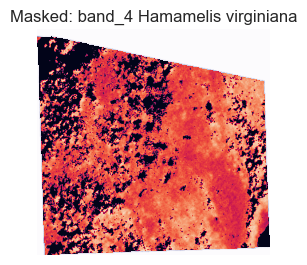

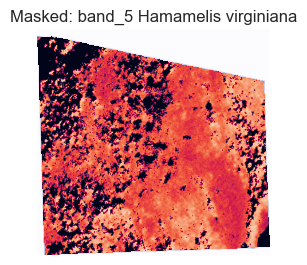

...

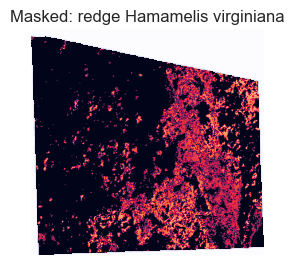

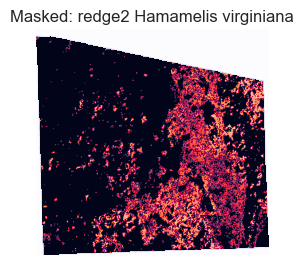

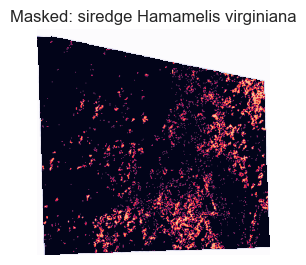

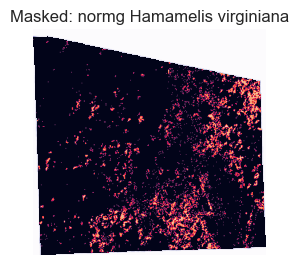

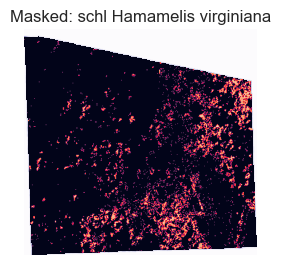

--------------------------------------------------------------------------------
left edge coord:	547467.0	
bottom edge coord:	5065233.0	
right edge coord:	554571.0	
top edge coord:	5069460.0	
dataset width:	2368	
dataset height:	1409	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32610	
data transform
	| 3.00, 0.00, 547467.00|
| 0.00,-3.00, 5069460.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


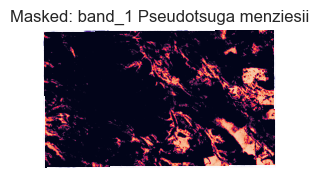

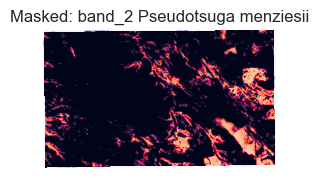

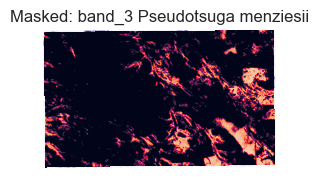

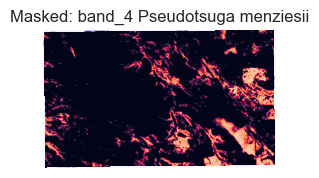

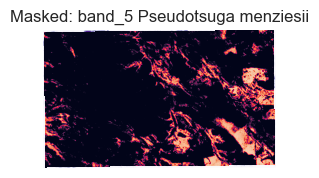

...

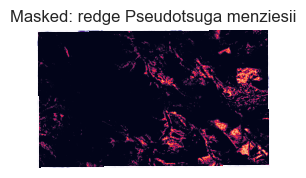

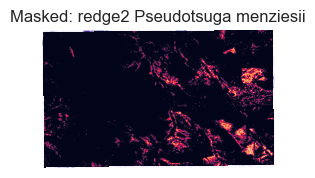

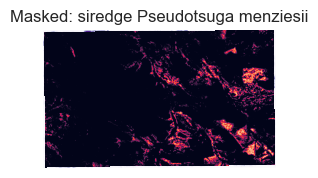

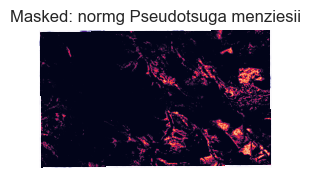

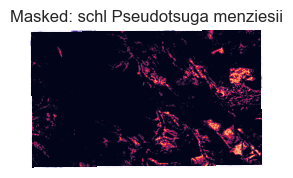

--------------------------------------------------------------------------------
left edge coord:	402555.0	
bottom edge coord:	3284304.0	
right edge coord:	403680.0	
top edge coord:	3284412.0	
dataset width:	375	
dataset height:	36	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 402555.00|
| 0.00,-3.00, 3284412.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


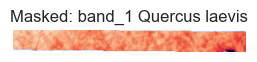

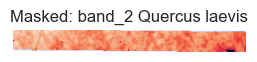

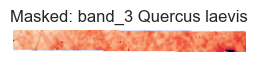

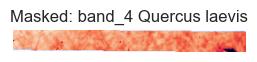

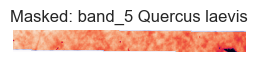

...

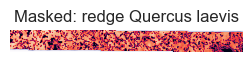

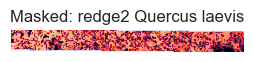

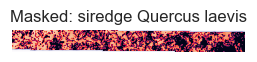

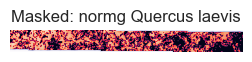

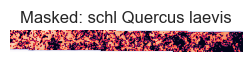

--------------------------------------------------------------------------------
left edge coord:	238671.0	
bottom edge coord:	4713870.0	
right edge coord:	239592.0	
top edge coord:	4714881.0	
dataset width:	307	
dataset height:	337	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32619	
data transform
	| 3.00, 0.00, 238671.00|
| 0.00,-3.00, 4714881.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
ALL NAN
--------------------------------------------------------------------------------
left edge coord:	386202.0	
bottom edge coord:	3519627.0	
right edge coord:	390342.0	
top edge coord:	3525336.0	
dataset width:	1380	
dataset height:	1903	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 386202.00|
| 0.00,-3.00, 3525336.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


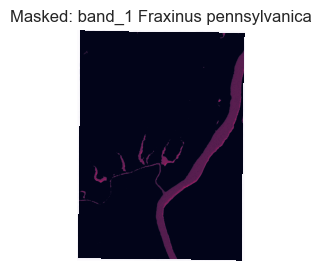

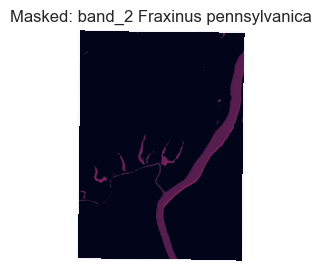

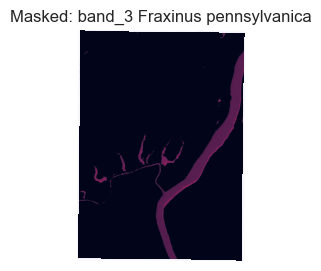

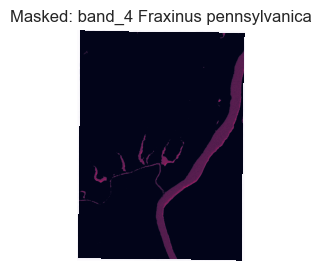

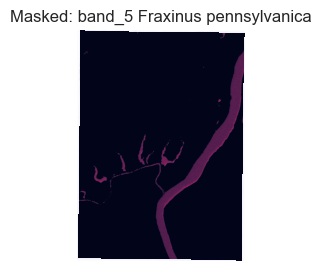

...

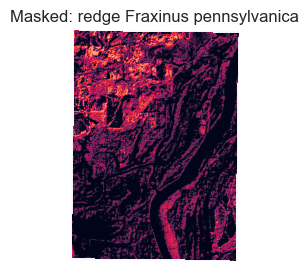

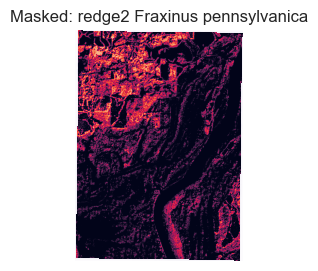

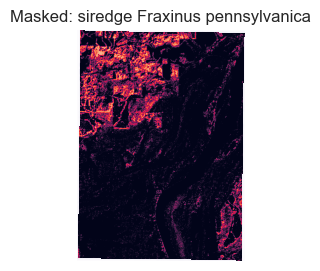

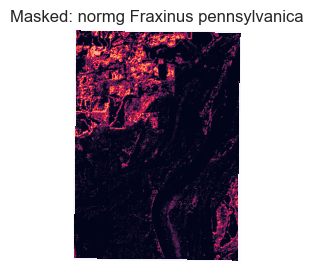

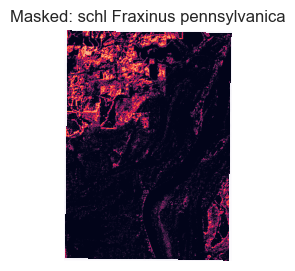

--------------------------------------------------------------------------------
left edge coord:	353436.0	
bottom edge coord:	5181363.0	
right edge coord:	353892.0	
top edge coord:	5181639.0	
dataset width:	152	
dataset height:	92	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32614	
data transform
	| 3.00, 0.00, 353436.00|
| 0.00,-3.00, 5181639.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
ALL NAN
--------------------------------------------------------------------------------
left edge coord:	254709.0	
bottom edge coord:	2163195.0	
right edge coord:	257526.0	
top edge coord:	2164857.0	
dataset width:	939	
dataset height:	554	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32605	
data transform
	| 3.00, 0.00, 254709.00|
| 0.00,-3.00, 2164857.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


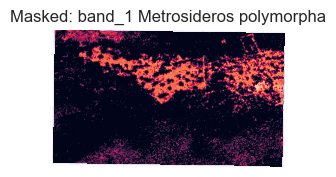

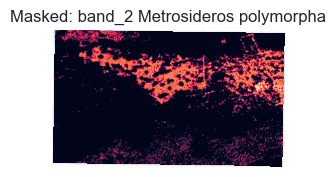

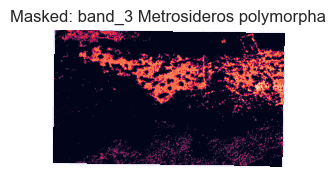

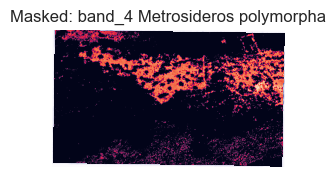

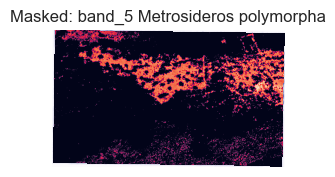

...

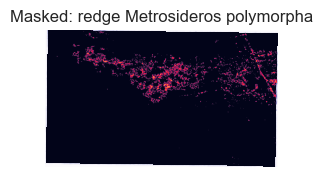

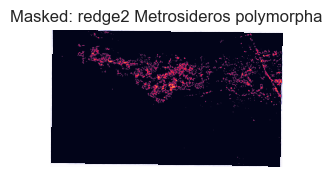

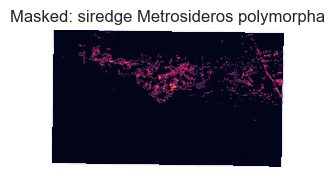

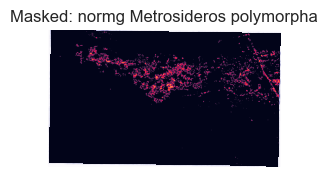

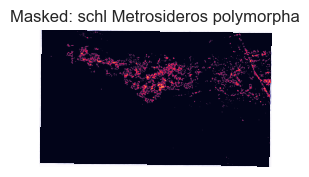

--------------------------------------------------------------------------------
left edge coord:	707841.0	
bottom edge coord:	4329291.0	
right edge coord:	711699.0	
top edge coord:	4331934.0	
dataset width:	1286	
dataset height:	881	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32614	
data transform
	| 3.00, 0.00, 707841.00|
| 0.00,-3.00, 4331934.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


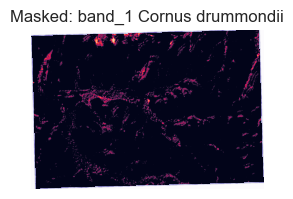

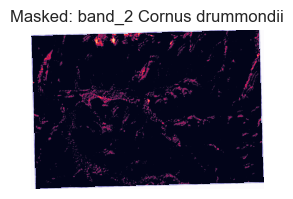

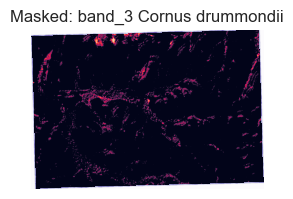

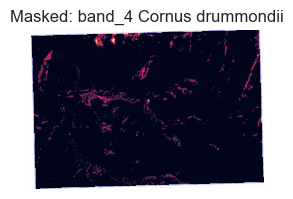

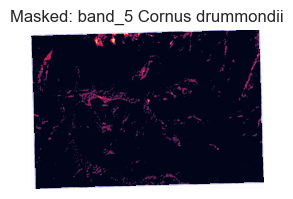

...

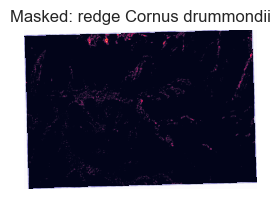

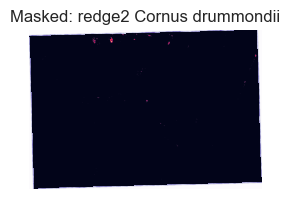

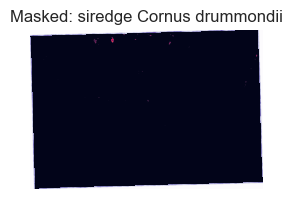

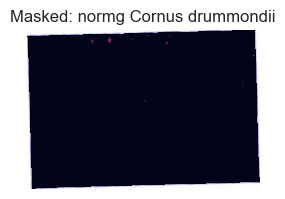

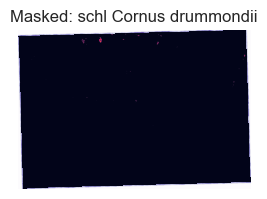

--------------------------------------------------------------------------------
left edge coord:	455484.0	
bottom edge coord:	4445238.0	
right edge coord:	458841.0	
top edge coord:	4450500.0	
dataset width:	1119	
dataset height:	1754	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32613	
data transform
	| 3.00, 0.00, 455484.00|
| 0.00,-3.00, 4450500.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


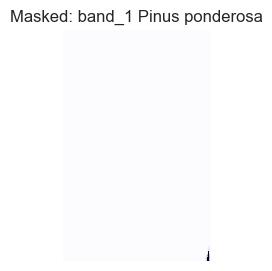

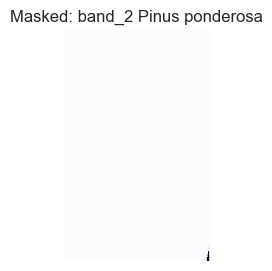

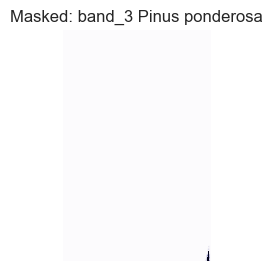

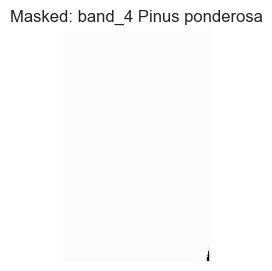

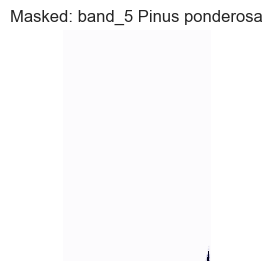

...

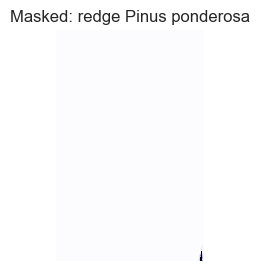

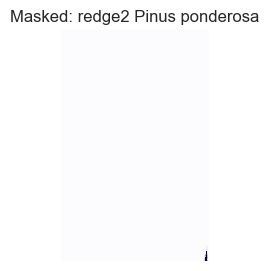

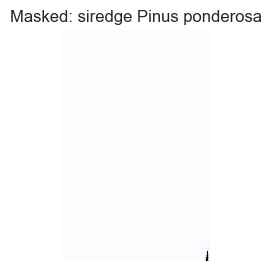

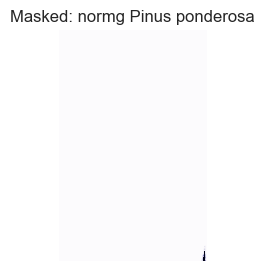

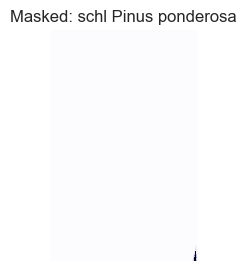

--------------------------------------------------------------------------------
left edge coord:	453474.0	
bottom edge coord:	4450413.0	
right edge coord:	460389.0	
top edge coord:	4458810.0	
dataset width:	2305	
dataset height:	2799	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32613	
data transform
	| 3.00, 0.00, 453474.00|
| 0.00,-3.00, 4458810.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


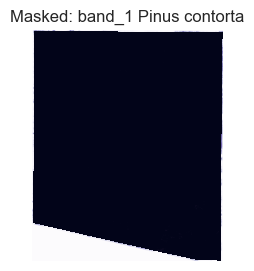

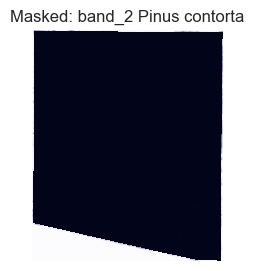

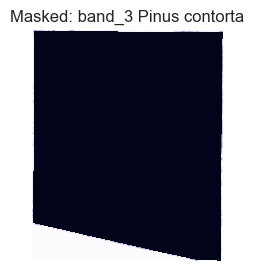

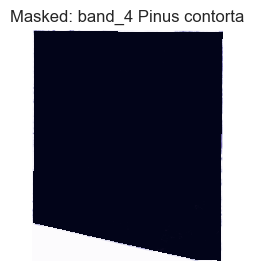

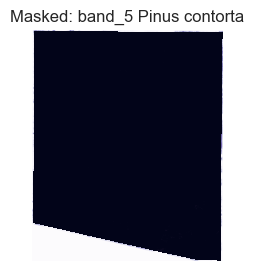

...

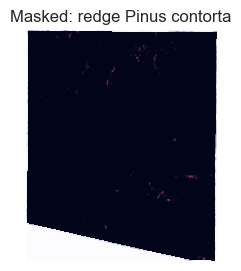

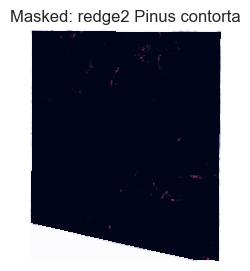

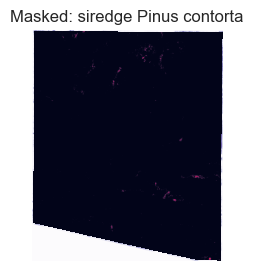

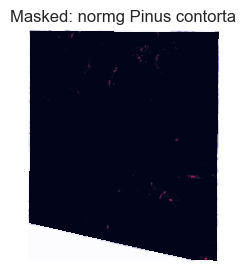

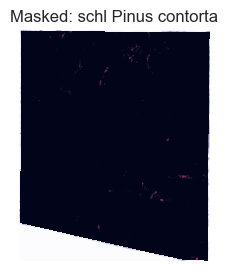

--------------------------------------------------------------------------------
left edge coord:	453708.0	
bottom edge coord:	4445445.0	
right edge coord:	454377.0	
top edge coord:	4448634.0	
dataset width:	223	
dataset height:	1063	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32613	
data transform
	| 3.00, 0.00, 453708.00|
| 0.00,-3.00, 4448634.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


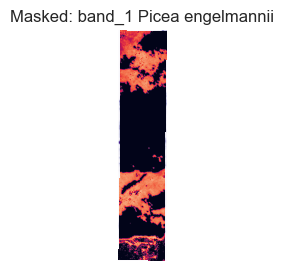

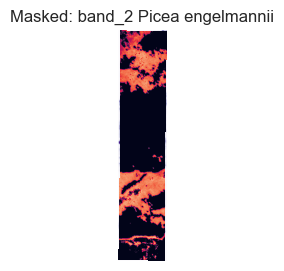

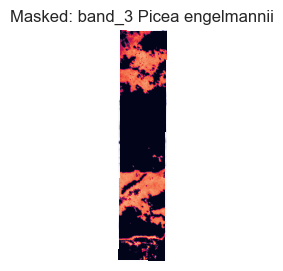

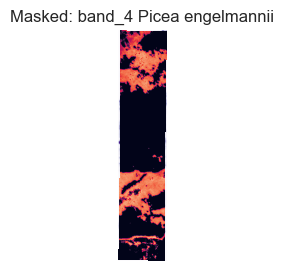

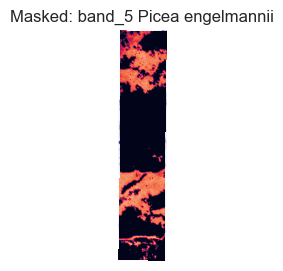

...

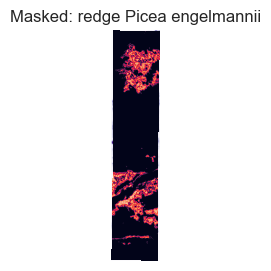

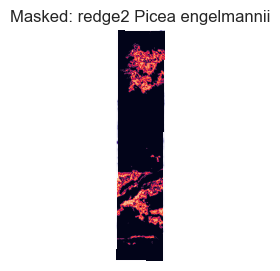

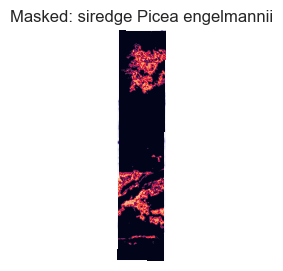

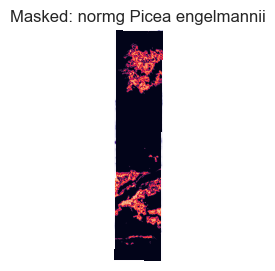

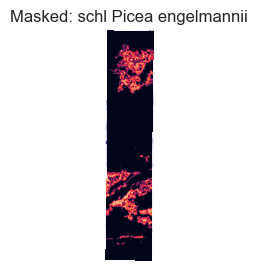

--------------------------------------------------------------------------------
left edge coord:	637521.0	
bottom edge coord:	4229886.0	
right edge coord:	645177.0	
top edge coord:	4237401.0	
dataset width:	2552	
dataset height:	2505	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32612	
data transform
	| 3.00, 0.00, 637521.00|
| 0.00,-3.00, 4237401.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
ALL NAN
--------------------------------------------------------------------------------
left edge coord:	722478.0	
bottom edge coord:	1986084.0	
right edge coord:	730398.0	
top edge coord:	1989252.0	
dataset width:	2640	
dataset height:	1056	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32619	
data transform
	| 3.00, 0.00, 722478.00|
| 0.00,-3.00, 1989252.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


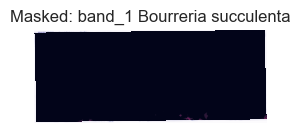

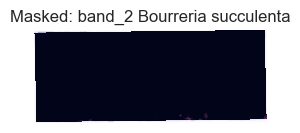

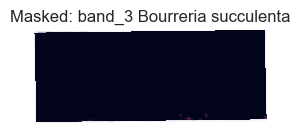

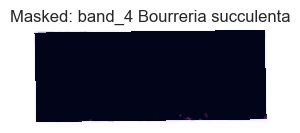

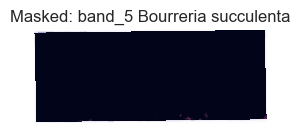

...

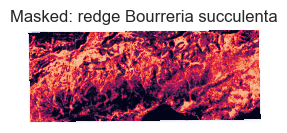

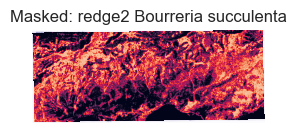

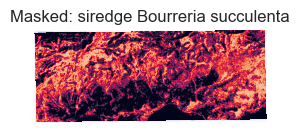

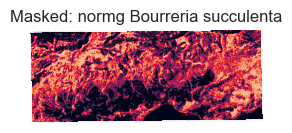

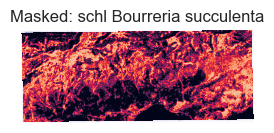

--------------------------------------------------------------------------------
left edge coord:	258465.0	
bottom edge coord:	4107213.0	
right edge coord:	258504.0	
top edge coord:	4107621.0	
dataset width:	13	
dataset height:	136	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32611	
data transform
	| 3.00, 0.00, 258465.00|
| 0.00,-3.00, 4107621.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


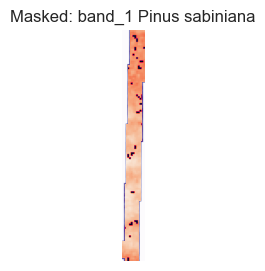

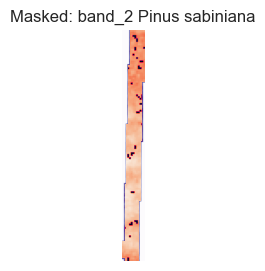

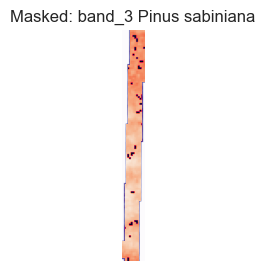

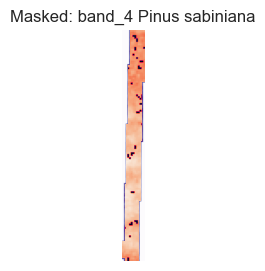

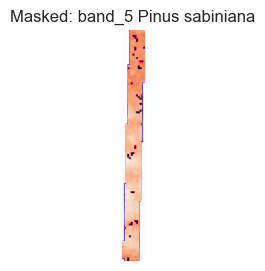

...

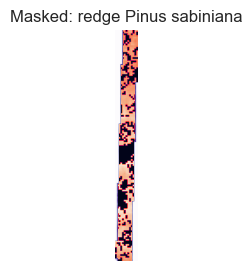

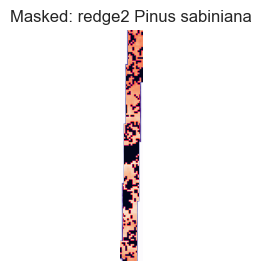

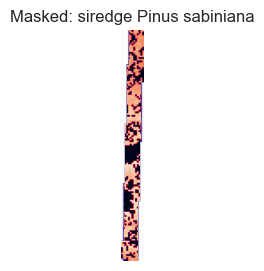

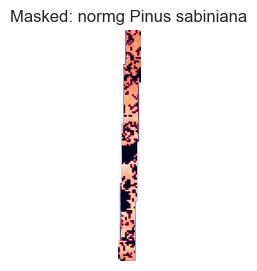

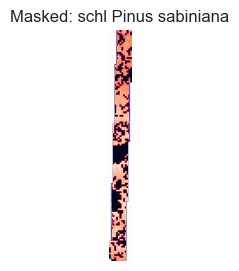

--------------------------------------------------------------------------------
left edge coord:	527712.0	
bottom edge coord:	4972347.0	
right edge coord:	546549.0	
top edge coord:	4980117.0	
dataset width:	6279	
dataset height:	2590	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32612	
data transform
	| 3.00, 0.00, 527712.00|
| 0.00,-3.00, 4980117.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
ALL NAN
--------------------------------------------------------------------------------
left edge coord:	459801.0	
bottom edge coord:	4449765.0	
right edge coord:	460257.0	
top edge coord:	4450011.0	
dataset width:	152	
dataset height:	82	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32613	
data transform
	| 3.00, 0.00, 459801.00|
| 0.00,-3.00, 4450011.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


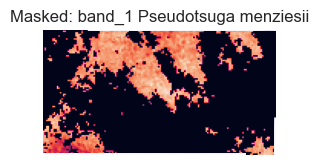

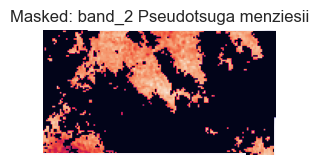

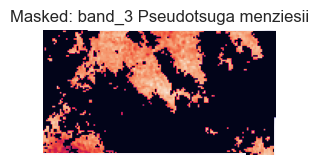

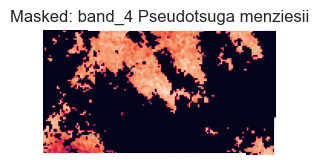

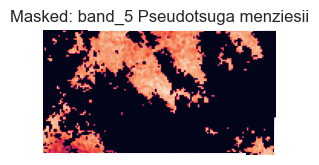

...

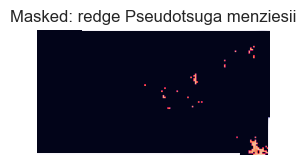

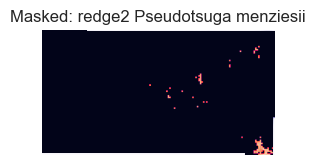

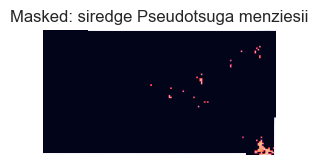

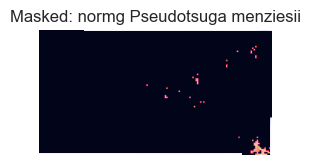

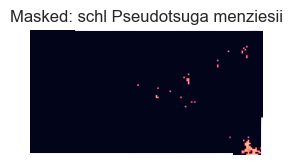

--------------------------------------------------------------------------------
left edge coord:	308823.0	
bottom edge coord:	4322565.0	
right edge coord:	310848.0	
top edge coord:	4325148.0	
dataset width:	675	
dataset height:	861	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32615	
data transform
	| 3.00, 0.00, 308823.00|
| 0.00,-3.00, 4325148.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------


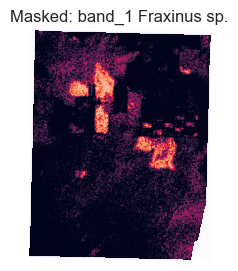

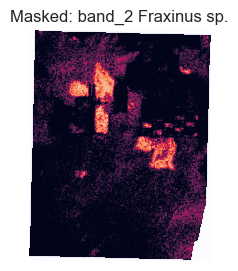

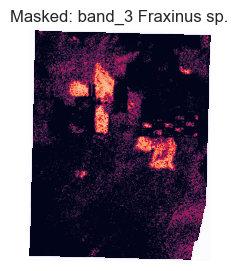

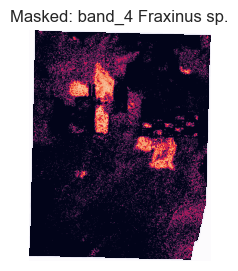

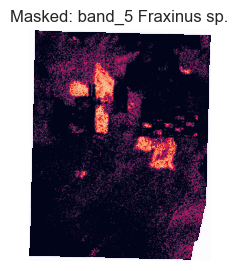

...

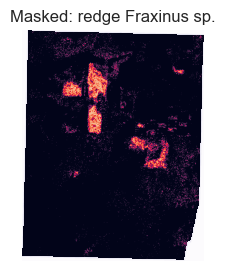

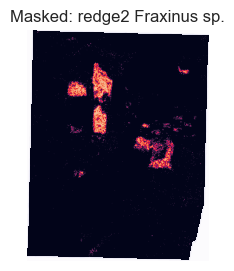

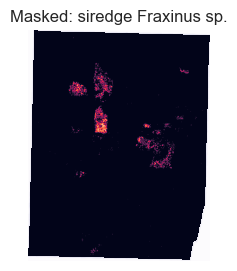

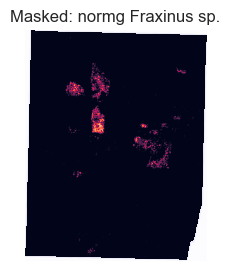

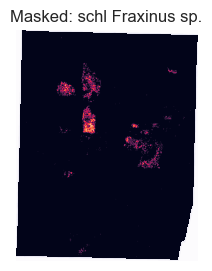

In [9]:
from remseno import *
n = 3
id_col = 'uid.x'
training_rows = []
err = 0
image_masks = {}
# Cool! So now we want to collect the values that pass all the masking...
for image_id in set(df['image_ids'].values):
    sub_df = df[df['image_ids'] == image_id]
    try:
        species = sub_df['species'].values[0]
        t_ids = sub_df[id_col].values
        img_path = sub_df['path'].values[0]
        ni = 0
        if img_path != None:
            o = Image()
            o.load_image(image_path=img_path)
            o.name = species
            # Do this for each image, and also plot any coordinates on them as well 
            # Image bands is something like below, we leave it up to the user to define i.e. could be indicies
            image_bands = []
            for band in bands: # Always normalise so that it is easier for
                normed = o.image.read(band)
                image_bands.append(normed)
            img = o.image

            nitian, ndvi, sr, tvi, gi, gndvi, pri, osavi, tcari, redge, redge2, siredge, normg, schl, schlcar = get_all_planetscope(img)
            info_cols = image_bands + [nitian, ndvi, sr, tvi, gi, gndvi, pri, osavi, tcari, redge, redge2, siredge, normg, schl, schlcar]
            masks = []
            all_nan = False
            for i, col in enumerate(masking_cols):
                # Now we want to build a total mask...
                mean_v = np.nanmedian(ind_df[col].values)
                std_v = np.nanstd(ind_df[col].values)
                lower_bound = mean_v - std_v 
                upper_bound = mean_v + std_v 
                # Check if the mask is all 0's
                m = mask_values(info_cols[i], lower_bound, upper_bound)
                if not np.any(m):
                    print("ALL NAN")
                    all_nan = True
                    break
                masks.append(m)
            if not all_nan:
                total_mask = masks[0]
                for mi, mask in enumerate(masks[1:]):

                    total_mask *= mask
                    # Plot each tree individually and the class that it belongs to
                    ax = o.plot(2, show_plot=False)
                    ax.imshow(total_mask*ndvi)
                    plt.title(f'Masked: {masking_cols[mi]} {species}')
                    plt.show()
                # Save the values that are over a certain amount and also then save them as training data
                positions = np.where(total_mask > 0)                
                image_masks[image_id] = total_mask

    except:
        print(image_id)

In [13]:
sub_df

,plotID,uid.x,namedLocation,date,tagEventID,domainID,siteID,plotID.1,subplotID,nestedSubplotID,...,species,genera,family,binary_label,x0,x1,y0,y1,image_ids,path
33,BART_001,6ee24fc9-019f-4186-9bd6-5a33f55f47b4,BART_001.basePlot.vst,2014-08-13T00:00:00Z,vst_BART_2014,D01,BART,BART_001,32.0,2.0,...,Betula alleghaniensis,Betula,Betulaceae,1,44.043972,44.050222,-71.308873,-71.304369,20221205_151318_64_247e,../data/harvard/sat_img/82cdf9be-21ee-49c7-aa7...
34,BART_002,f935c01d-8a39-45c7-a780-e244761c8981,BART_002.basePlot.vst,2014-09-03T00:00:00Z,vst_BART_2014,D01,BART,BART_002,40.0,3.0,...,Fagus grandifolia,Fagus,Fagaceae,1,44.032007,44.038257,-71.275128,-71.270624,20221205_151318_64_247e,../data/harvard/sat_img/82cdf9be-21ee-49c7-aa7...
35,BART_003,afe53140-1ee0-4eaf-953f-f071a685125a,BART_003.basePlot.vst,2014-09-16T00:00:00Z,vst_BART_2014,D01,BART,BART_003,31.0,1.0,...,Acer rubrum,Acer,Sapindaceae,1,44.052144,44.058394,-71.265435,-71.260931,20221205_151318_64_247e,../data/harvard/sat_img/82cdf9be-21ee-49c7-aa7...
36,BART_004,57ba1a50-7540-4f67-b422-bed8d8c9d3bc,BART_004.basePlot.vst,2014-09-11T00:00:00Z,vst_BART_2014,D01,BART,BART_004,32.0,4.0,...,Tsuga canadensis,Tsuga,Pinaceae,1,44.038510,44.044760,-71.289188,-71.284684,20221205_151318_64_247e,../data/harvard/sat_img/82cdf9be-21ee-49c7-aa7...
37,BART_005,7bfe07bf-bf9f-48b6-8cdc-a7b8c320a4d5,BART_005.basePlot.vst,2014-08-27T00:00:00Z,vst_BART_2014,D01,BART,BART_005,41.0,1.0,...,Picea sp.,Picea,Betulaceae,1,44.051525,44.057775,-71.284505,-71.280001,20221205_151318_64_247e,../data/harvard/sat_img/82cdf9be-21ee-49c7-aa7...
38,BART_006,1f14f059-f50c-4d1d-b0e5-dcfa04bc79a5,BART_006.basePlot.vst,2014-09-03T00:00:00Z,vst_BART_2014,D01,BART,BART_006,40.0,3.0,...,Fagus grandifolia,Fagus,Fagaceae,1,44.057409,44.063659,-71.313207,-71.308703,20221205_151318_64_247e,../data/harvard/sat_img/82cdf9be-21ee-49c7-aa7...
39,BART_007,988fe05a-573c-4295-8e3c-e6c90e17b2b9,BART_007.basePlot.vst,2014-09-04T00:00:00Z,vst_BART_2014,D01,BART,BART_007,40.0,3.0,...,Tsuga canadensis,Tsuga,Pinaceae,1,44.046581,44.052831,-71.300780,-71.296276,20221205_151318_64_247e,../data/harvard/sat_img/82cdf9be-21ee-49c7-aa7...
40,BART_010,992f2d77-0482-4b7e-8b7d-ea998b317ee3,BART_010.basePlot.vst,2014-09-10T00:00:00Z,vst_BART_2014,D01,BART,BART_010,31.0,4.0,...,Fagus grandifolia,Fagus,Fagaceae,1,44.046990,44.053240,-71.268909,-71.264404,20221205_151318_64_247e,../data/harvard/sat_img/82cdf9be-21ee-49c7-aa7...
41,BART_011,d020255b-2097-41dd-b092-030fe1d36c05,BART_011.basePlot.vst,2014-09-05T00:00:00Z,vst_BART_2014,D01,BART,BART_011,31.0,2.0,...,Betula alleghaniensis,Betula,Betulaceae,1,44.046902,44.053152,-71.298498,-71.293994,20221205_151318_64_247e,../data/harvard/sat_img/82cdf9be-21ee-49c7-aa7...
42,BART_012,80ca3ee7-534e-4c95-84d8-2da04aeb8926,BART_012.basePlot.vst,2014-08-05T00:00:00Z,vst_BART_2014,D01,BART,BART_012,41.0,1.0,...,Fagus grandifolia,Fagus,Fagaceae,1,44.042959,44.049209,-71.318566,-71.314062,20221205_151318_64_247e,../data/harvard/sat_img/82cdf9be-21ee-49c7-aa7...


--------------------------------------------------------------------------------
                            20221205_151318_64_247e	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	314397.0	
bottom edge coord:	4878261.0	
right edge coord:	318870.0	
top edge coord:	4882029.0	
dataset width:	1491	
dataset height:	1256	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32619	
data transform
	| 3.00, 0.00, 314397.00|
| 0.00,-3.00, 4882029.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	39	
Now you have:	39	
--------------------------------------------------------

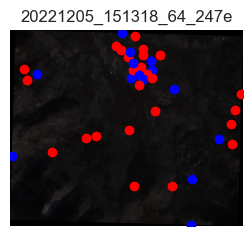

--------------------------------------------------------------------------------
                            20221209_144120_41_241d	                            
--------------------------------------------------------------------------------
20221209_144120_41_241d
--------------------------------------------------------------------------------
                            20221209_144122_74_241d	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	724062.0	
bottom edge coord:	4705722.0	
right edge coord:	725283.0	
top edge coord:	4706907.0	
dataset width:	407	
dataset height:	395	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32618	
data transform
	| 3.00, 0.00, 724062.00|
| 0.00,-3.00, 4706907.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
----------------

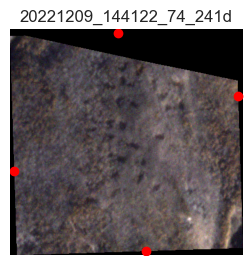

--------------------------------------------------------------------------------
                            20221216_151524_30_2460	                            
--------------------------------------------------------------------------------
20221216_151524_30_2460
--------------------------------------------------------------------------------
                            20221225_195717_82_2465	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	254709.0	
bottom edge coord:	2163195.0	
right edge coord:	257526.0	
top edge coord:	2164857.0	
dataset width:	939	
dataset height:	554	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32605	
data transform
	| 3.00, 0.00, 254709.00|
| 0.00,-3.00, 2164857.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
----------------

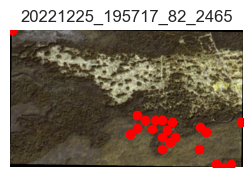

--------------------------------------------------------------------------------
                            20230105_155345_20_24a5	                            
--------------------------------------------------------------------------------
20230105_155345_20_24a5
--------------------------------------------------------------------------------
                            20230107_152018_85_245c	                            
--------------------------------------------------------------------------------
20230107_152018_85_245c
--------------------------------------------------------------------------------
                            20230109_135817_84_2449	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	703962.0	
bottom edge coord:	1995051.0	
right edge coord:	704643.0	
top edge coord:	1995165.0	
dataset width:	227	
dataset he

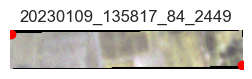

--------------------------------------------------------------------------------
                            20230114_153642_73_2432	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	386202.0	
bottom edge coord:	3519627.0	
right edge coord:	390342.0	
top edge coord:	3525336.0	
dataset width:	1380	
dataset height:	1903	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 386202.00|
| 0.00,-3.00, 3525336.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	29	
Now you have:	29	
--------------------------------------------------------

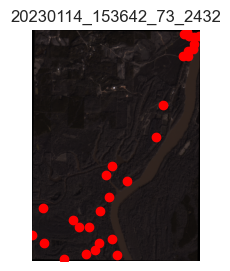

--------------------------------------------------------------------------------
                            20230117_150904_95_2429	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	402555.0	
bottom edge coord:	3284304.0	
right edge coord:	403680.0	
top edge coord:	3284412.0	
dataset width:	375	
dataset height:	36	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 402555.00|
| 0.00,-3.00, 3284412.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	31	
Now you have:	31	
-----------------------------------------------------------

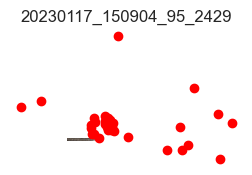

--------------------------------------------------------------------------------
                            20230117_150907_20_2429	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	400767.0	
bottom edge coord:	3283620.0	
right edge coord:	408909.0	
top edge coord:	3288369.0	
dataset width:	2714	
dataset height:	1583	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 400767.00|
| 0.00,-3.00, 3288369.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	2	
Now you have:	2	
----------------------------------------------------------

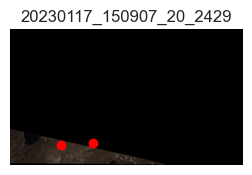

--------------------------------------------------------------------------------
                            20230122_165044_01_245c	                            
--------------------------------------------------------------------------------
20230122_165044_01_245c
--------------------------------------------------------------------------------
                            20230127_153020_32_241b	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	457497.0	
bottom edge coord:	3638574.0	
right edge coord:	463581.0	
top edge coord:	3648906.0	
dataset width:	2028	
dataset height:	3444	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 457497.00|
| 0.00,-3.00, 3648906.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------

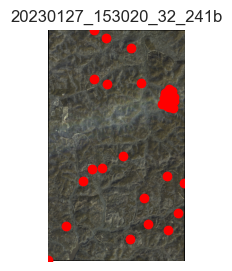

--------------------------------------------------------------------------------
                            20230127_153118_97_2436	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	423069.0	
bottom edge coord:	3598392.0	
right edge coord:	424971.0	
top edge coord:	3600876.0	
dataset width:	634	
dataset height:	828	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 423069.00|
| 0.00,-3.00, 3600876.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	38	
Now you have:	38	
----------------------------------------------------------

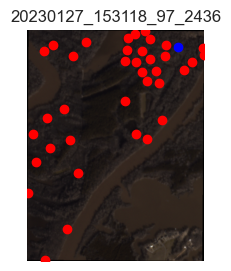

--------------------------------------------------------------------------------
                            20230131_162243_70_2445	                            
--------------------------------------------------------------------------------
20230131_162243_70_2445
--------------------------------------------------------------------------------
                            20230201_165048_85_2439	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	459801.0	
bottom edge coord:	4449765.0	
right edge coord:	460257.0	
top edge coord:	4450011.0	
dataset width:	152	
dataset height:	82	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32613	
data transform
	| 3.00, 0.00, 459801.00|
| 0.00,-3.00, 4450011.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
-----------------

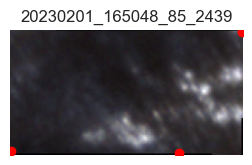

--------------------------------------------------------------------------------
                            20230201_165051_10_2439	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	455484.0	
bottom edge coord:	4445238.0	
right edge coord:	458841.0	
top edge coord:	4450500.0	
dataset width:	1119	
dataset height:	1754	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32613	
data transform
	| 3.00, 0.00, 455484.00|
| 0.00,-3.00, 4450500.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	1	
Now you have:	1	
----------------------------------------------------------

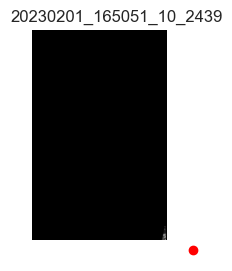

--------------------------------------------------------------------------------
                            20230202_165610_66_24c4	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	453474.0	
bottom edge coord:	4450413.0	
right edge coord:	460389.0	
top edge coord:	4458810.0	
dataset width:	2305	
dataset height:	2799	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32613	
data transform
	| 3.00, 0.00, 453474.00|
| 0.00,-3.00, 4458810.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	11	
Now you have:	11	
--------------------------------------------------------

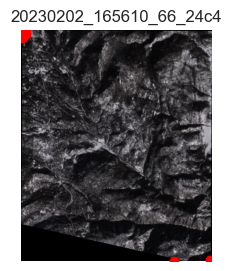

--------------------------------------------------------------------------------
                            20230202_174009_84_2455	                            
--------------------------------------------------------------------------------
20230202_174009_84_2455
--------------------------------------------------------------------------------
                            20230203_143959_36_2453	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	725430.0	
bottom edge coord:	4696971.0	
right edge coord:	730566.0	
top edge coord:	4704486.0	
dataset width:	1712	
dataset height:	2505	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32618	
data transform
	| 3.00, 0.00, 725430.00|
| 0.00,-3.00, 4704486.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------

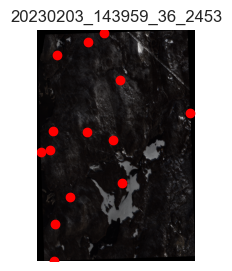

--------------------------------------------------------------------------------
                            20230203_154848_71_2459	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	297261.0	
bottom edge coord:	5039433.0	
right edge coord:	300720.0	
top edge coord:	5042892.0	
dataset width:	1153	
dataset height:	1153	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 297261.00|
| 0.00,-3.00, 5042892.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	57	
Now you have:	57	
--------------------------------------------------------

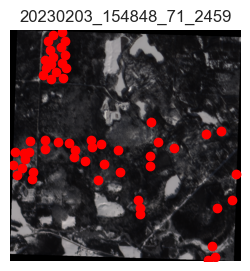

--------------------------------------------------------------------------------
                            20230204_152834_22_24b9	                            
--------------------------------------------------------------------------------
20230204_152834_22_24b9
--------------------------------------------------------------------------------
                            20230204_152836_60_24b9	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	743646.0	
bottom edge coord:	3982101.0	
right edge coord:	751380.0	
top edge coord:	3985563.0	
dataset width:	2578	
dataset height:	1154	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 743646.00|
| 0.00,-3.00, 3985563.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------

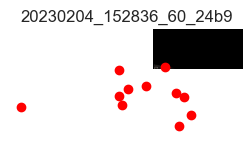

--------------------------------------------------------------------------------
                            20230207_150402_23_2448	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	461217.0	
bottom edge coord:	3105102.0	
right edge coord:	462273.0	
top edge coord:	3105558.0	
dataset width:	352	
dataset height:	152	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 461217.00|
| 0.00,-3.00, 3105558.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	2	
Now you have:	2	
------------------------------------------------------------

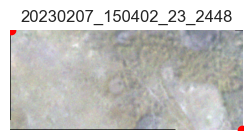

--------------------------------------------------------------------------------
                            20230207_150404_42_2448	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	460401.0	
bottom edge coord:	3101655.0	
right edge coord:	461352.0	
top edge coord:	3103728.0	
dataset width:	317	
dataset height:	691	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 460401.00|
| 0.00,-3.00, 3103728.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	4	
Now you have:	4	
------------------------------------------------------------

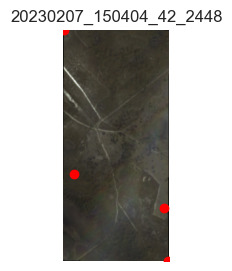

--------------------------------------------------------------------------------
                            20230207_165016_82_241a	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	453708.0	
bottom edge coord:	4445445.0	
right edge coord:	454377.0	
top edge coord:	4448634.0	
dataset width:	223	
dataset height:	1063	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32613	
data transform
	| 3.00, 0.00, 453708.00|
| 0.00,-3.00, 4448634.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	5	
Now you have:	5	
-----------------------------------------------------------

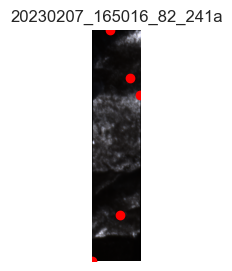

--------------------------------------------------------------------------------
                            20230207_165019_11_241a	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	449898.0	
bottom edge coord:	4431669.0	
right edge coord:	453732.0	
top edge coord:	4434252.0	
dataset width:	1278	
dataset height:	861	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32613	
data transform
	| 3.00, 0.00, 449898.00|
| 0.00,-3.00, 4434252.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	38	
Now you have:	38	
---------------------------------------------------------

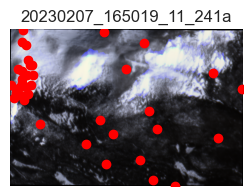

--------------------------------------------------------------------------------
                            20230207_170642_45_2421	                            
--------------------------------------------------------------------------------
20230207_170642_45_2421
--------------------------------------------------------------------------------
                            20230207_170644_64_2421	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	508491.0	
bottom edge coord:	3515208.0	
right edge coord:	511710.0	
top edge coord:	3519357.0	
dataset width:	1073	
dataset height:	1383	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32612	
data transform
	| 3.00, 0.00, 508491.00|
| 0.00,-3.00, 3519357.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------

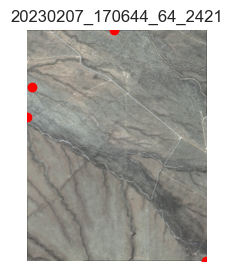

--------------------------------------------------------------------------------
                            20230208_161337_36_2262	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	303906.0	
bottom edge coord:	5122662.0	
right edge coord:	304800.0	
top edge coord:	5123439.0	
dataset width:	298	
dataset height:	259	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 303906.00|
| 0.00,-3.00, 5123439.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	20	
Now you have:	20	
----------------------------------------------------------

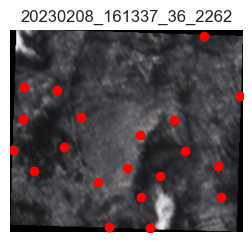

--------------------------------------------------------------------------------
                            20230208_174942_34_24c3	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	258465.0	
bottom edge coord:	4107213.0	
right edge coord:	258504.0	
top edge coord:	4107621.0	
dataset width:	13	
dataset height:	136	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32611	
data transform
	| 3.00, 0.00, 258465.00|
| 0.00,-3.00, 4107621.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	4	
Now you have:	4	
-------------------------------------------------------------

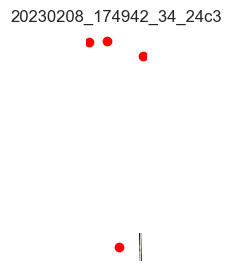

--------------------------------------------------------------------------------
                            20230208_175050_48_24b5	                            
--------------------------------------------------------------------------------
20230208_175050_48_24b5
--------------------------------------------------------------------------------
                            20230210_165544_98_24c4	                            
--------------------------------------------------------------------------------
20230210_165544_98_24c4
--------------------------------------------------------------------------------
                            20230211_151336_76_24cf	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	537594.0	
bottom edge coord:	4134600.0	
right edge coord:	545244.0	
top edge coord:	4142967.0	
dataset width:	2550	
dataset h

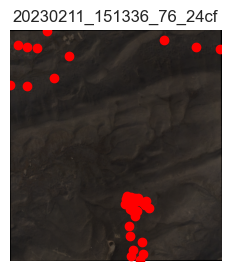

--------------------------------------------------------------------------------
                            20230211_164337_15_24ca	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	353436.0	
bottom edge coord:	5181363.0	
right edge coord:	353892.0	
top edge coord:	5181639.0	
dataset width:	152	
dataset height:	92	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32614	
data transform
	| 3.00, 0.00, 353436.00|
| 0.00,-3.00, 5181639.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	8	
Now you have:	8	
-------------------------------------------------------------

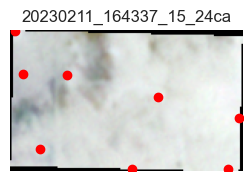

--------------------------------------------------------------------------------
                            20230212_151534_59_247d	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	238671.0	
bottom edge coord:	4713870.0	
right edge coord:	239592.0	
top edge coord:	4714881.0	
dataset width:	307	
dataset height:	337	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32619	
data transform
	| 3.00, 0.00, 238671.00|
| 0.00,-3.00, 4714881.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	21	
Now you have:	21	
----------------------------------------------------------

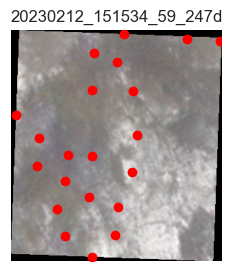

--------------------------------------------------------------------------------
                            20230212_161323_12_241f	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	624402.0	
bottom edge coord:	3688617.0	
right edge coord:	633453.0	
top edge coord:	3698370.0	
dataset width:	3017	
dataset height:	3251	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32614	
data transform
	| 3.00, 0.00, 624402.00|
| 0.00,-3.00, 3698370.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	47	
Now you have:	47	
--------------------------------------------------------

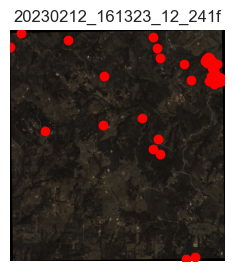

--------------------------------------------------------------------------------
                            20230212_171021_39_2423	                            
--------------------------------------------------------------------------------
20230212_171021_39_2423
--------------------------------------------------------------------------------
                            20230212_180741_09_24af	                            
--------------------------------------------------------------------------------
20230212_180741_09_24af
--------------------------------------------------------------------------------
                            20230213_145140_57_2442	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	363981.0	
bottom edge coord:	4303329.0	
right edge coord:	367011.0	
top edge coord:	4306221.0	
dataset width:	1010	
dataset h

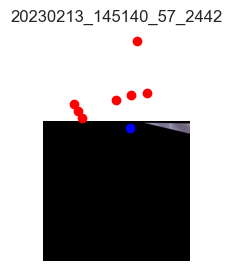

--------------------------------------------------------------------------------
                            20230213_145142_76_2442	                            
--------------------------------------------------------------------------------
20230213_145142_76_2442
--------------------------------------------------------------------------------
                            20230213_152347_35_24b6	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	741096.0	
bottom edge coord:	3453864.0	
right edge coord:	741846.0	
top edge coord:	3454641.0	
dataset width:	250	
dataset height:	259	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 741096.00|
| 0.00,-3.00, 3454641.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
----------------

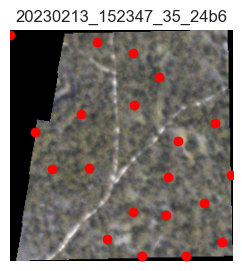

--------------------------------------------------------------------------------
                            20230214_150439_86_24b5	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	242748.0	
bottom edge coord:	4329894.0	
right edge coord:	244440.0	
top edge coord:	4330746.0	
dataset width:	564	
dataset height:	284	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32618	
data transform
	| 3.00, 0.00, 242748.00|
| 0.00,-3.00, 4330746.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	10	
Now you have:	10	
----------------------------------------------------------

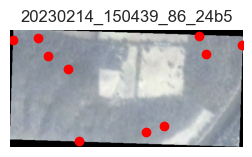

--------------------------------------------------------------------------------
                            20230214_150532_41_24a9	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	752997.0	
bottom edge coord:	4327188.0	
right edge coord:	753372.0	
top edge coord:	4327686.0	
dataset width:	125	
dataset height:	166	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 752997.00|
| 0.00,-3.00, 4327686.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	12	
Now you have:	12	
----------------------------------------------------------

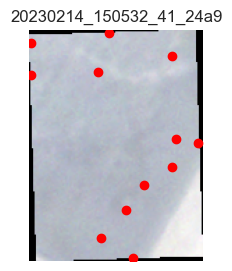

--------------------------------------------------------------------------------
                            20230214_150537_20_24a9	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	745929.0	
bottom edge coord:	4305849.0	
right edge coord:	749844.0	
top edge coord:	4310088.0	
dataset width:	1305	
dataset height:	1413	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 745929.00|
| 0.00,-3.00, 4310088.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	34	
Now you have:	34	
--------------------------------------------------------

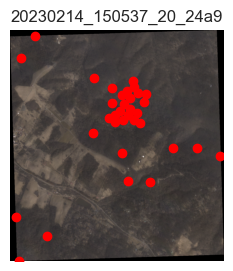

--------------------------------------------------------------------------------
                            20230214_163701_71_24b2	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	491580.0	
bottom edge coord:	5222997.0	
right edge coord:	492066.0	
top edge coord:	5223600.0	
dataset width:	162	
dataset height:	201	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32614	
data transform
	| 3.00, 0.00, 491580.00|
| 0.00,-3.00, 5223600.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	10	
Now you have:	10	
----------------------------------------------------------

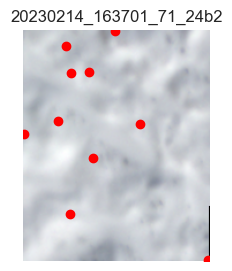

--------------------------------------------------------------------------------
                            20230215_174152_35_241b	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	297024.0	
bottom edge coord:	4099995.0	
right edge coord:	300573.0	
top edge coord:	4101555.0	
dataset width:	1183	
dataset height:	520	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32611	
data transform
	| 3.00, 0.00, 297024.00|
| 0.00,-3.00, 4101555.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	37	
Now you have:	37	
---------------------------------------------------------

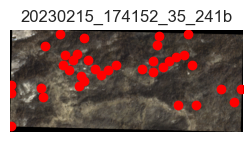

--------------------------------------------------------------------------------
                            20230216_140832_76_24b3	                            
--------------------------------------------------------------------------------
20230216_140832_76_24b3
--------------------------------------------------------------------------------
                            20230216_175015_05_247f	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	527712.0	
bottom edge coord:	4972347.0	
right edge coord:	546549.0	
top edge coord:	4980117.0	
dataset width:	6279	
dataset height:	2590	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32612	
data transform
	| 3.00, 0.00, 527712.00|
| 0.00,-3.00, 4980117.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------

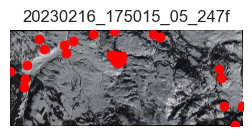

--------------------------------------------------------------------------------
                            20230217_160009_83_24c0	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	724902.0	
bottom edge coord:	5074335.0	
right edge coord:	729453.0	
top edge coord:	5079876.0	
dataset width:	1517	
dataset height:	1847	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32615	
data transform
	| 3.00, 0.00, 724902.00|
| 0.00,-3.00, 5079876.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	19	
Now you have:	19	
--------------------------------------------------------

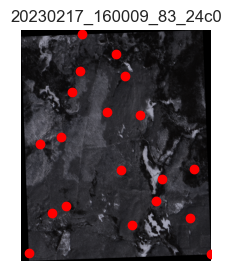

--------------------------------------------------------------------------------
                            20230218_151212_59_24d0	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	457230.0	
bottom edge coord:	3102606.0	
right edge coord:	460785.0	
top edge coord:	3110418.0	
dataset width:	1185	
dataset height:	2604	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 457230.00|
| 0.00,-3.00, 3110418.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	14	
Now you have:	14	
--------------------------------------------------------

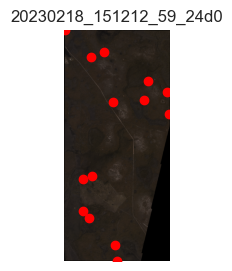

--------------------------------------------------------------------------------
                            20230218_200358_79_2459	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	560481.0	
bottom edge coord:	7078782.0	
right edge coord:	562953.0	
top edge coord:	7090677.0	
dataset width:	824	
dataset height:	3965	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32606	
data transform
	| 3.00, 0.00, 560481.00|
| 0.00,-3.00, 7090677.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	31	
Now you have:	31	
---------------------------------------------------------

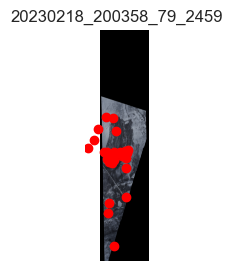

--------------------------------------------------------------------------------
                            20230218_201600_96_245c	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	474843.0	
bottom edge coord:	7229982.0	
right edge coord:	479196.0	
top edge coord:	7230354.0	
dataset width:	1451	
dataset height:	124	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32606	
data transform
	| 3.00, 0.00, 474843.00|
| 0.00,-3.00, 7230354.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	4	
Now you have:	4	
-----------------------------------------------------------

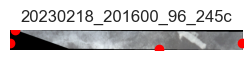

--------------------------------------------------------------------------------
                            20230218_202045_10_241d	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	387570.0	
bottom edge coord:	7083672.0	
right edge coord:	391878.0	
top edge coord:	7087248.0	
dataset width:	1436	
dataset height:	1192	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32606	
data transform
	| 3.00, 0.00, 387570.00|
| 0.00,-3.00, 7087248.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	27	
Now you have:	27	
--------------------------------------------------------

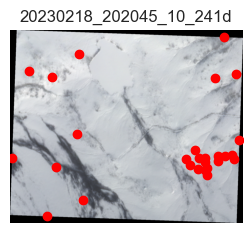

--------------------------------------------------------------------------------
                            20230218_205453_20_248c	                            
--------------------------------------------------------------------------------
20230218_205453_20_248c
--------------------------------------------------------------------------------
                            20230220_140048_78_2465	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	722478.0	
bottom edge coord:	1986084.0	
right edge coord:	730398.0	
top edge coord:	1989252.0	
dataset width:	2640	
dataset height:	1056	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32619	
data transform
	| 3.00, 0.00, 722478.00|
| 0.00,-3.00, 1989252.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------

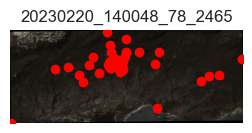

--------------------------------------------------------------------------------
                            20230220_161850_71_24d0	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	707841.0	
bottom edge coord:	4329291.0	
right edge coord:	711699.0	
top edge coord:	4331934.0	
dataset width:	1286	
dataset height:	881	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32614	
data transform
	| 3.00, 0.00, 707841.00|
| 0.00,-3.00, 4331934.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	33	
Now you have:	33	
---------------------------------------------------------

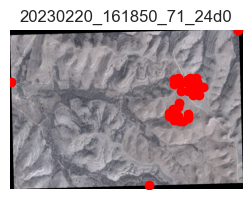

--------------------------------------------------------------------------------
                            20230220_163134_04_241f	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	481314.0	
bottom edge coord:	5219280.0	
right edge coord:	483999.0	
top edge coord:	5222043.0	
dataset width:	895	
dataset height:	921	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32614	
data transform
	| 3.00, 0.00, 481314.00|
| 0.00,-3.00, 5222043.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	12	
Now you have:	12	
----------------------------------------------------------

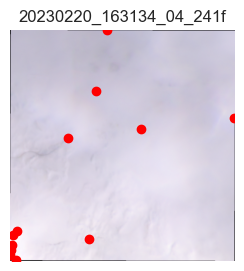

--------------------------------------------------------------------------------
                            20230223_200723_67_241f	                            
--------------------------------------------------------------------------------
20230223_200723_67_241f
--------------------------------------------------------------------------------
                            20230224_164933_84_2439	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	521499.0	
bottom edge coord:	4517463.0	
right edge coord:	526875.0	
top edge coord:	4523964.0	
dataset width:	1792	
dataset height:	2167	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32613	
data transform
	| 3.00, 0.00, 521499.00|
| 0.00,-3.00, 4523964.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------

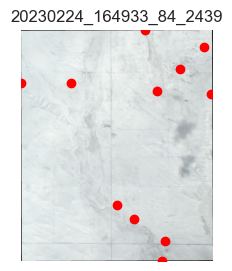

--------------------------------------------------------------------------------
                            20230224_165144_69_2439	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	328743.0	
bottom edge coord:	3605661.0	
right edge coord:	331638.0	
top edge coord:	3610344.0	
dataset width:	965	
dataset height:	1561	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32613	
data transform
	| 3.00, 0.00, 328743.00|
| 0.00,-3.00, 3610344.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	42	
Now you have:	42	
---------------------------------------------------------

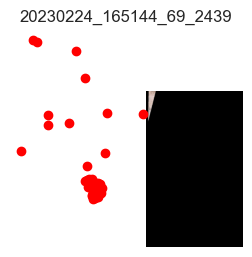

--------------------------------------------------------------------------------
                            20230224_165405_98_2445	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	637521.0	
bottom edge coord:	4229886.0	
right edge coord:	645177.0	
top edge coord:	4237401.0	
dataset width:	2552	
dataset height:	2505	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32612	
data transform
	| 3.00, 0.00, 637521.00|
| 0.00,-3.00, 4237401.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	42	
Now you have:	42	
--------------------------------------------------------

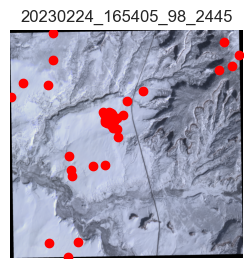

--------------------------------------------------------------------------------
                            20230224_171110_17_24c4	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	514413.0	
bottom edge coord:	3522777.0	
right edge coord:	517476.0	
top edge coord:	3530808.0	
dataset width:	1021	
dataset height:	2677	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32612	
data transform
	| 3.00, 0.00, 514413.00|
| 0.00,-3.00, 3530808.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	3	
Now you have:	3	
----------------------------------------------------------

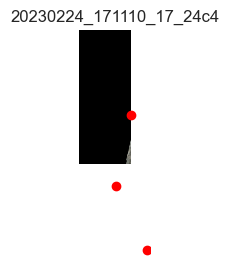

--------------------------------------------------------------------------------
                            20230224_174641_52_24c2	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	320598.0	
bottom edge coord:	4096518.0	
right edge coord:	321945.0	
top edge coord:	4097760.0	
dataset width:	449	
dataset height:	414	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32611	
data transform
	| 3.00, 0.00, 320598.00|
| 0.00,-3.00, 4097760.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	20	
Now you have:	20	
----------------------------------------------------------

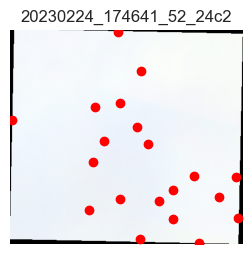

--------------------------------------------------------------------------------
                            20230224_180120_67_2459	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	547467.0	
bottom edge coord:	5065233.0	
right edge coord:	554571.0	
top edge coord:	5069460.0	
dataset width:	2368	
dataset height:	1409	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32610	
data transform
	| 3.00, 0.00, 547467.00|
| 0.00,-3.00, 5069460.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	33	
Now you have:	33	
--------------------------------------------------------

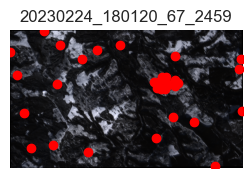

--------------------------------------------------------------------------------
                            20230225_160855_95_2429	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	308823.0	
bottom edge coord:	4322565.0	
right edge coord:	310848.0	
top edge coord:	4325148.0	
dataset width:	675	
dataset height:	861	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32615	
data transform
	| 3.00, 0.00, 308823.00|
| 0.00,-3.00, 4325148.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	38	
Now you have:	38	
----------------------------------------------------------

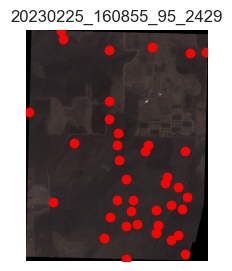

--------------------------------------------------------------------------------
                            20230225_164722_09_241b	                            
--------------------------------------------------------------------------------
20230225_164722_09_241b
--------------------------------------------------------------------------------
                            20230225_172401_60_24c9	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	368595.0	
bottom edge coord:	4444863.0	
right edge coord:	378291.0	
top edge coord:	4452483.0	
dataset width:	3232	
dataset height:	2540	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32612	
data transform
	| 3.00, 0.00, 368595.00|
| 0.00,-3.00, 4452483.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------

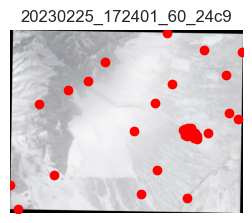

--------------------------------------------------------------------------------
                            20230225_180154_60_2431	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	576168.0	
bottom edge coord:	5073549.0	
right edge coord:	589305.0	
top edge coord:	5078037.0	
dataset width:	4379	
dataset height:	1496	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32610	
data transform
	| 3.00, 0.00, 576168.00|
| 0.00,-3.00, 5078037.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	38	
Now you have:	38	
--------------------------------------------------------

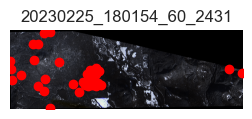

In [15]:
# Now have a look at the locations on each of the images.
# Group by image_id and see how many of them get plotted on the same image...
grouped = df.groupby('image_ids')
u = SciUtil()
for image_id, sub_df in grouped:
    try:
        u.dp([image_id])
        # Make a df on the coordinates and see how many fall on the 500m2 that I downloaded... might need to make more
        # or we could use for validation.
        # Get xmin, xmax, ymin and ymax of the region and padd by 100m
        sub_df.to_csv(f'{data_dir}coords/img_{image_id}.csv', index=False)
        img_path = sub_df['path'].values[0]
        o = Image()
        o.load_image(image_path=img_path)
        c = Coords(f'{data_dir}coords/img_{image_id}.csv', x_col='Latitude', y_col='Longitude', label_col='species',
               id_col='uid.x', sep=',', class1='Fagus grandifolia', class2='Acer rubrum', crs="EPSG:4326")
        c.transform_coords(tree_coords="EPSG:4326", image_coords=str(o.image.crs), plot=False)
        ax = o.plot_rbg()
        # Plot on ax now
        c.plot_on_ax(ax, o)
        plt.title(image_id)
        plt.show()
    except:
        print(image_id)

# Validate whether the pixels were "masked"

1. Here we validate whether or not the pixels were masked
2. If not masked, let's get their values from the incidices and check what their prediction was

In [17]:
sub_df

,plotID,uid.x,namedLocation,date,tagEventID,domainID,siteID,plotID.1,subplotID,nestedSubplotID,...,species,genera,family,binary_label,x0,x1,y0,y1,image_ids,path
1254,WREF_001,5f7f7a77-a195-4b18-b48c-d7e9ff90098f,WREF_001.basePlot.vst,2019-11-26T00:00:00Z,vst_WREF_2019,D16,WREF,WREF_001,41.0,NaN,...,Tsuga heterophylla,Tsuga,Pinaceae,1,45.840857,45.847107,-122.001317,-121.996813,20230225_180154_60_2431,../data/harvard/sat_img/590ccb7d-dc44-45e9-a5e...
1255,WREF_002,99a02b7b-699e-4f63-95a8-7bcd71c35523,WREF_002.basePlot.vst,2019-07-22T00:00:00Z,vst_WREF_2019,D16,WREF,WREF_002,31.0,NaN,...,Tsuga heterophylla,Tsuga,Pinaceae,1,45.808180,45.814430,-121.993026,-121.988521,20230225_180154_60_2431,../data/harvard/sat_img/590ccb7d-dc44-45e9-a5e...
1256,WREF_003,8b171fa3-6c78-418d-afca-8587b273f5d3,WREF_003.basePlot.vst,2019-11-14T00:00:00Z,vst_WREF_2019,D16,WREF,WREF_003,41.0,1.0,...,Abies amabilis,Abies,Pinaceae,1,45.828413,45.834663,-122.020870,-122.016366,20230225_180154_60_2431,../data/harvard/sat_img/590ccb7d-dc44-45e9-a5e...
1257,WREF_004,61db4f86-db57-49d2-b15d-770b1bc4c0c6,WREF_004.basePlot.vst,2019-07-16T00:00:00Z,vst_WREF_2019,D16,WREF,WREF_004,41.0,NaN,...,Pseudotsuga menziesii,Pseudotsuga,Pinaceae,1,45.819848,45.826098,-122.000991,-121.996486,20230225_180154_60_2431,../data/harvard/sat_img/590ccb7d-dc44-45e9-a5e...
1258,WREF_005,18e31220-a049-48fc-aed3-e3753e892416,WREF_005.basePlot.vst,2019-07-22T00:00:00Z,vst_WREF_2019,D16,WREF,WREF_005,31.0,NaN,...,Abies amabilis,Abies,Pinaceae,1,45.841167,45.847417,-122.004762,-122.000258,20230225_180154_60_2431,../data/harvard/sat_img/590ccb7d-dc44-45e9-a5e...
1259,WREF_007,325c3cd6-1af9-4bc6-ae9f-fe8fd0571633,WREF_007.basePlot.vst,2019-07-22T00:00:00Z,vst_WREF_2019,D16,WREF,WREF_007,32.0,NaN,...,Tsuga heterophylla,Tsuga,Pinaceae,1,45.846992,45.853242,-121.991972,-121.987467,20230225_180154_60_2431,../data/harvard/sat_img/590ccb7d-dc44-45e9-a5e...
1260,WREF_008,b003d802-2726-4467-b833-0fcfd4c7d9b1,WREF_008.basePlot.vst,2019-07-22T00:00:00Z,vst_WREF_2019,D16,WREF,WREF_008,41.0,NaN,...,Tsuga heterophylla,Tsuga,Pinaceae,1,45.820499,45.826749,-121.975740,-121.971236,20230225_180154_60_2431,../data/harvard/sat_img/590ccb7d-dc44-45e9-a5e...
1261,WREF_009,fc05d2de-976d-4e0a-9a6c-4a5eddb34578,WREF_009.basePlot.vst,2019-11-20T00:00:00Z,vst_WREF_2019,D16,WREF,WREF_009,40.0,4.0,...,Pseudotsuga menziesii,Pseudotsuga,Pinaceae,1,45.832899,45.839149,-122.004197,-121.999692,20230225_180154_60_2431,../data/harvard/sat_img/590ccb7d-dc44-45e9-a5e...
1262,WREF_010,22a8a4a3-6e76-4612-a70c-ef560a106e57,WREF_010.basePlot.vst,2019-07-22T00:00:00Z,vst_WREF_2019,D16,WREF,WREF_010,32.0,NaN,...,Pseudotsuga menziesii,Pseudotsuga,Pinaceae,1,45.825142,45.831392,-121.852855,-121.848351,20230225_180154_60_2431,../data/harvard/sat_img/590ccb7d-dc44-45e9-a5e...
1263,WREF_011,de3ebc09-7db2-4334-a94c-c8e7ea138057,WREF_011.basePlot.vst,2019-07-17T00:00:00Z,vst_WREF_2019,D16,WREF,WREF_011,31.0,1.0,...,Pseudotsuga menziesii,Pseudotsuga,Pinaceae,1,45.831577,45.837827,-121.985675,-121.981170,20230225_180154_60_2431,../data/harvard/sat_img/590ccb7d-dc44-45e9-a5e...


In [40]:
# Now have a look at the locations on each of the images.
# Group by image_id and see how many of them get plotted on the same image...
grouped = df.groupby('image_ids')
u = SciUtil()
rows = []
err = 0
for image_id, sub_df in grouped:
    #try:
    u.dp([image_id])
    # Make a df on the coordinates and see how many fall on the 500m2 that I downloaded... might need to make more
    # or we could use for validation.
    # Get xmin, xmax, ymin and ymax of the region and padd by 100m
    sub_df.to_csv(f'{data_dir}coords/img_{image_id}.csv', index=False)
    img_path = sub_df['path'].values[0]
    if img_path is not None:
        o = Image()
        o.load_image(image_path=img_path)
        c = Coords(f'{data_dir}coords/img_{image_id}.csv', x_col='Latitude', y_col='Longitude', label_col='species',
               id_col='uid.x', sep=',', class1='Fagus grandifolia', class2='Acer rubrum', crs="EPSG:4326")
        c.transform_coords(tree_coords="EPSG:4326", image_coords=str(o.image.crs), plot=False)
        # For each point get the XY coords, the mask and the values
        image_bands = []
        for band in bands: # Always normalise so that it is easier for
            normed = o.image.read(band)
            image_bands.append(normed)
        img = o.image

        nitian, ndvi, sr, tvi, gi, gndvi, pri, osavi, tcari, redge, redge2, siredge, normg, schl, schlcar = get_all_planetscope(img)
        info_cols = image_bands + [nitian, ndvi, sr, tvi, gi, gndvi, pri, osavi, tcari, redge, redge2, siredge, normg, schl, schlcar]
        mask =image_masks.get(image_id)
        for d in c.df[['uid.x', 'species', 'Latitude', 'Longitude']].values:
            try:
                y, x = o.image.index(d[2], d[3])
                row = list(d) + get_features_for_xy(y, x, o) + [mask[y, x]]
                rows.append(row)
            except: # This occurs when the image doesn't actually cover all the trees
                err += 1
    #     except:
    #         print(image_id)

--------------------------------------------------------------------------------
                            20221205_151318_64_247e	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	314397.0	
bottom edge coord:	4878261.0	
right edge coord:	318870.0	
top edge coord:	4882029.0	
dataset width:	1491	
dataset height:	1256	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32619	
data transform
	| 3.00, 0.00, 314397.00|
| 0.00,-3.00, 4882029.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	39	
Now you have:	39	
--------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20221209_144120_41_241d	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
                            20221209_144122_74_241d	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	724062.0	
bottom edge coord:	4705722.0	
right edge coord:	725283.0	
top edge coord:	4706907.0	
dataset width:	407	
dataset height:	395	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32618	
data transform
	| 3.00, 0.00, 724062.00|
| 0.00,-3.00, 4706907.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
----------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230105_155345_20_24a5	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
                            20230107_152018_85_245c	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
                            20230109_135817_84_2449	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	703962.0	
bottom edge coord:	1995051.0	
right edge coord:	704643.0	
top edge coord:	1995165.0	
dataset width:	227	
dataset height:	38	
number of bands:	(1, 2, 3, 4, 5, 6, 7,

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230117_150904_95_2429	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	402555.0	
bottom edge coord:	3284304.0	
right edge coord:	403680.0	
top edge coord:	3284412.0	
dataset width:	375	
dataset height:	36	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 402555.00|
| 0.00,-3.00, 3284412.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	31	
Now you have:	31	
-----------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230117_150907_20_2429	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	400767.0	
bottom edge coord:	3283620.0	
right edge coord:	408909.0	
top edge coord:	3288369.0	
dataset width:	2714	
dataset height:	1583	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 400767.00|
| 0.00,-3.00, 3288369.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	2	
Now you have:	2	
----------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230122_165044_01_245c	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
                            20230127_153020_32_241b	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	457497.0	
bottom edge coord:	3638574.0	
right edge coord:	463581.0	
top edge coord:	3648906.0	
dataset width:	2028	
dataset height:	3444	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 457497.00|
| 0.00,-3.00, 3648906.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230127_153118_97_2436	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	423069.0	
bottom edge coord:	3598392.0	
right edge coord:	424971.0	
top edge coord:	3600876.0	
dataset width:	634	
dataset height:	828	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 423069.00|
| 0.00,-3.00, 3600876.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	38	
Now you have:	38	
----------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230131_162243_70_2445	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
                            20230201_165048_85_2439	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	459801.0	
bottom edge coord:	4449765.0	
right edge coord:	460257.0	
top edge coord:	4450011.0	
dataset width:	152	
dataset height:	82	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32613	
data transform
	| 3.00, 0.00, 459801.00|
| 0.00,-3.00, 4450011.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
-----------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230202_165610_66_24c4	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	453474.0	
bottom edge coord:	4450413.0	
right edge coord:	460389.0	
top edge coord:	4458810.0	
dataset width:	2305	
dataset height:	2799	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32613	
data transform
	| 3.00, 0.00, 453474.00|
| 0.00,-3.00, 4458810.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	11	
Now you have:	11	
--------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230202_174009_84_2455	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
                            20230203_143959_36_2453	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	725430.0	
bottom edge coord:	4696971.0	
right edge coord:	730566.0	
top edge coord:	4704486.0	
dataset width:	1712	
dataset height:	2505	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32618	
data transform
	| 3.00, 0.00, 725430.00|
| 0.00,-3.00, 4704486.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230203_154848_71_2459	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	297261.0	
bottom edge coord:	5039433.0	
right edge coord:	300720.0	
top edge coord:	5042892.0	
dataset width:	1153	
dataset height:	1153	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 297261.00|
| 0.00,-3.00, 5042892.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	57	
Now you have:	57	
--------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230204_152834_22_24b9	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
                            20230204_152836_60_24b9	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	743646.0	
bottom edge coord:	3982101.0	
right edge coord:	751380.0	
top edge coord:	3985563.0	
dataset width:	2578	
dataset height:	1154	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 743646.00|
| 0.00,-3.00, 3985563.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230207_150402_23_2448	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	461217.0	
bottom edge coord:	3105102.0	
right edge coord:	462273.0	
top edge coord:	3105558.0	
dataset width:	352	
dataset height:	152	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 461217.00|
| 0.00,-3.00, 3105558.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	2	
Now you have:	2	
------------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230207_165016_82_241a	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	453708.0	
bottom edge coord:	4445445.0	
right edge coord:	454377.0	
top edge coord:	4448634.0	
dataset width:	223	
dataset height:	1063	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32613	
data transform
	| 3.00, 0.00, 453708.00|
| 0.00,-3.00, 4448634.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	5	
Now you have:	5	
-----------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:325: RuntimeWarning: invalid value encountered in divide
  redge = nir / green * r_edge
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:351: RuntimeWarning: invalid value encountered in divide
  redge2 = red_band / green * r_edge
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:372: RuntimeWarning: invalid value encountered in divide
  siredge = red_band / r_edge
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:395: RuntimeWarning: invalid value encountered in divide
  normg = green_band / (green_band + blue_band + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packag

--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	38	
Now you have:	38	
--------------------------------------------------------------------------------


/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230207_170642_45_2421	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
                            20230207_170644_64_2421	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	508491.0	
bottom edge coord:	3515208.0	
right edge coord:	511710.0	
top edge coord:	3519357.0	
dataset width:	1073	
dataset height:	1383	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32612	
data transform
	| 3.00, 0.00, 508491.00|
| 0.00,-3.00, 3519357.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230208_161337_36_2262	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	303906.0	
bottom edge coord:	5122662.0	
right edge coord:	304800.0	
top edge coord:	5123439.0	
dataset width:	298	
dataset height:	259	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 303906.00|
| 0.00,-3.00, 5123439.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	20	
Now you have:	20	
----------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230208_174942_34_24c3	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	258465.0	
bottom edge coord:	4107213.0	
right edge coord:	258504.0	
top edge coord:	4107621.0	
dataset width:	13	
dataset height:	136	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32611	
data transform
	| 3.00, 0.00, 258465.00|
| 0.00,-3.00, 4107621.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	4	
Now you have:	4	
-------------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230211_164337_15_24ca	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	353436.0	
bottom edge coord:	5181363.0	
right edge coord:	353892.0	
top edge coord:	5181639.0	
dataset width:	152	
dataset height:	92	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32614	
data transform
	| 3.00, 0.00, 353436.00|
| 0.00,-3.00, 5181639.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	8	
Now you have:	8	
-------------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230212_151534_59_247d	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	238671.0	
bottom edge coord:	4713870.0	
right edge coord:	239592.0	
top edge coord:	4714881.0	
dataset width:	307	
dataset height:	337	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32619	
data transform
	| 3.00, 0.00, 238671.00|
| 0.00,-3.00, 4714881.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	21	
Now you have:	21	
----------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:372: RuntimeWarning: invalid value encountered in divide
  siredge = red_band / r_edge
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:395: RuntimeWarning: invalid value encountered in divide
  normg = green_band / (green_band + blue_band + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:423: RuntimeWarning: invalid value encountered in divide
  schl = (nir_band - rededge_band) / (nir_band + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:450: RuntimeWarning: invalid value encountered in divide
  schlcar = (greeni_band - red_band) / (greeni_band + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs

--------------------------------------------------------------------------------
                            20230212_161323_12_241f	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	624402.0	
bottom edge coord:	3688617.0	
right edge coord:	633453.0	
top edge coord:	3698370.0	
dataset width:	3017	
dataset height:	3251	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32614	
data transform
	| 3.00, 0.00, 624402.00|
| 0.00,-3.00, 3698370.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	47	
Now you have:	47	
--------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230212_171021_39_2423	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
                            20230212_180741_09_24af	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
                            20230213_145140_57_2442	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	363981.0	
bottom edge coord:	4303329.0	
right edge coord:	367011.0	
top edge coord:	4306221.0	
dataset width:	1010	
dataset height:	964	
number of bands:	(1, 2, 3, 4, 5, 6, 

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230213_145142_76_2442	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
                            20230213_152347_35_24b6	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	741096.0	
bottom edge coord:	3453864.0	
right edge coord:	741846.0	
top edge coord:	3454641.0	
dataset width:	250	
dataset height:	259	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32616	
data transform
	| 3.00, 0.00, 741096.00|
| 0.00,-3.00, 3454641.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
----------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230214_150439_86_24b5	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	242748.0	
bottom edge coord:	4329894.0	
right edge coord:	244440.0	
top edge coord:	4330746.0	
dataset width:	564	
dataset height:	284	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32618	
data transform
	| 3.00, 0.00, 242748.00|
| 0.00,-3.00, 4330746.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	10	
Now you have:	10	
----------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230214_150532_41_24a9	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	752997.0	
bottom edge coord:	4327188.0	
right edge coord:	753372.0	
top edge coord:	4327686.0	
dataset width:	125	
dataset height:	166	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 752997.00|
| 0.00,-3.00, 4327686.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	12	
Now you have:	12	
----------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230214_163701_71_24b2	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	491580.0	
bottom edge coord:	5222997.0	
right edge coord:	492066.0	
top edge coord:	5223600.0	
dataset width:	162	
dataset height:	201	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32614	
data transform
	| 3.00, 0.00, 491580.00|
| 0.00,-3.00, 5223600.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	10	
Now you have:	10	
----------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230216_140832_76_24b3	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
                            20230216_175015_05_247f	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	527712.0	
bottom edge coord:	4972347.0	
right edge coord:	546549.0	
top edge coord:	4980117.0	
dataset width:	6279	
dataset height:	2590	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32612	
data transform
	| 3.00, 0.00, 527712.00|
| 0.00,-3.00, 4980117.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230217_160009_83_24c0	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	724902.0	
bottom edge coord:	5074335.0	
right edge coord:	729453.0	
top edge coord:	5079876.0	
dataset width:	1517	
dataset height:	1847	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32615	
data transform
	| 3.00, 0.00, 724902.00|
| 0.00,-3.00, 5079876.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	19	
Now you have:	19	
--------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230218_151212_59_24d0	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	457230.0	
bottom edge coord:	3102606.0	
right edge coord:	460785.0	
top edge coord:	3110418.0	
dataset width:	1185	
dataset height:	2604	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32617	
data transform
	| 3.00, 0.00, 457230.00|
| 0.00,-3.00, 3110418.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	14	
Now you have:	14	
--------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230218_200358_79_2459	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	560481.0	
bottom edge coord:	7078782.0	
right edge coord:	562953.0	
top edge coord:	7090677.0	
dataset width:	824	
dataset height:	3965	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32606	
data transform
	| 3.00, 0.00, 560481.00|
| 0.00,-3.00, 7090677.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	31	
Now you have:	31	
---------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230218_201600_96_245c	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	474843.0	
bottom edge coord:	7229982.0	
right edge coord:	479196.0	
top edge coord:	7230354.0	
dataset width:	1451	
dataset height:	124	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32606	
data transform
	| 3.00, 0.00, 474843.00|
| 0.00,-3.00, 7230354.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	4	
Now you have:	4	
-----------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230218_202045_10_241d	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	387570.0	
bottom edge coord:	7083672.0	
right edge coord:	391878.0	
top edge coord:	7087248.0	
dataset width:	1436	
dataset height:	1192	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32606	
data transform
	| 3.00, 0.00, 387570.00|
| 0.00,-3.00, 7087248.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	27	
Now you have:	27	
--------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230218_205453_20_248c	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
                            20230220_140048_78_2465	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	722478.0	
bottom edge coord:	1986084.0	
right edge coord:	730398.0	
top edge coord:	1989252.0	
dataset width:	2640	
dataset height:	1056	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32619	
data transform
	| 3.00, 0.00, 722478.00|
| 0.00,-3.00, 1989252.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230220_161850_71_24d0	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	707841.0	
bottom edge coord:	4329291.0	
right edge coord:	711699.0	
top edge coord:	4331934.0	
dataset width:	1286	
dataset height:	881	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32614	
data transform
	| 3.00, 0.00, 707841.00|
| 0.00,-3.00, 4331934.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	33	
Now you have:	33	
---------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230220_163134_04_241f	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	481314.0	
bottom edge coord:	5219280.0	
right edge coord:	483999.0	
top edge coord:	5222043.0	
dataset width:	895	
dataset height:	921	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32614	
data transform
	| 3.00, 0.00, 481314.00|
| 0.00,-3.00, 5222043.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	12	
Now you have:	12	
----------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230223_200723_67_241f	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
                            20230224_164933_84_2439	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	521499.0	
bottom edge coord:	4517463.0	
right edge coord:	526875.0	
top edge coord:	4523964.0	
dataset width:	1792	
dataset height:	2167	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32613	
data transform
	| 3.00, 0.00, 521499.00|
| 0.00,-3.00, 4523964.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230224_165144_69_2439	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	328743.0	
bottom edge coord:	3605661.0	
right edge coord:	331638.0	
top edge coord:	3610344.0	
dataset width:	965	
dataset height:	1561	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32613	
data transform
	| 3.00, 0.00, 328743.00|
| 0.00,-3.00, 3610344.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	42	
Now you have:	42	
---------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230224_165405_98_2445	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	637521.0	
bottom edge coord:	4229886.0	
right edge coord:	645177.0	
top edge coord:	4237401.0	
dataset width:	2552	
dataset height:	2505	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32612	
data transform
	| 3.00, 0.00, 637521.00|
| 0.00,-3.00, 4237401.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	42	
Now you have:	42	
--------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230224_171110_17_24c4	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	514413.0	
bottom edge coord:	3522777.0	
right edge coord:	517476.0	
top edge coord:	3530808.0	
dataset width:	1021	
dataset height:	2677	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32612	
data transform
	| 3.00, 0.00, 514413.00|
| 0.00,-3.00, 3530808.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	3	
Now you have:	3	
----------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230224_174641_52_24c2	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	320598.0	
bottom edge coord:	4096518.0	
right edge coord:	321945.0	
top edge coord:	4097760.0	
dataset width:	449	
dataset height:	414	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32611	
data transform
	| 3.00, 0.00, 320598.00|
| 0.00,-3.00, 4097760.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	20	
Now you have:	20	
----------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230224_180120_67_2459	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	547467.0	
bottom edge coord:	5065233.0	
right edge coord:	554571.0	
top edge coord:	5069460.0	
dataset width:	2368	
dataset height:	1409	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32610	
data transform
	| 3.00, 0.00, 547467.00|
| 0.00,-3.00, 5069460.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	33	
Now you have:	33	
--------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230225_160855_95_2429	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	308823.0	
bottom edge coord:	4322565.0	
right edge coord:	310848.0	
top edge coord:	4325148.0	
dataset width:	675	
dataset height:	861	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32615	
data transform
	| 3.00, 0.00, 308823.00|
| 0.00,-3.00, 4325148.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	38	
Now you have:	38	
----------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230225_164722_09_241b	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
                            20230225_172401_60_24c9	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	368595.0	
bottom edge coord:	4444863.0	
right edge coord:	378291.0	
top edge coord:	4452483.0	
dataset width:	3232	
dataset height:	2540	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32612	
data transform
	| 3.00, 0.00, 368595.00|
| 0.00,-3.00, 4452483.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

--------------------------------------------------------------------------------
                            20230225_180154_60_2431	                            
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
left edge coord:	576168.0	
bottom edge coord:	5073549.0	
right edge coord:	589305.0	
top edge coord:	5078037.0	
dataset width:	4379	
dataset height:	1496	
number of bands:	(1, 2, 3, 4, 5, 6, 7, 8)	
geo ref system:	EPSG:32610	
data transform
	| 3.00, 0.00, 576168.00|
| 0.00,-3.00, 5078037.00|
| 0.00, 0.00, 1.00|	
--------------------------------------------------------------------------------
--------------------------------------------------------------------------------
Removed rows not in class1 or class2 i.e.	Fagus grandifolia	Acer rubrum	 in column:	species	Your dataset origionally had:	38	
Now you have:	38	
--------------------------------------------------------

/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:58: RuntimeWarning: invalid value encountered in divide
  nitian = r_edge / (r_edge + blue_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:83: RuntimeWarning: invalid value encountered in divide
  ndvi = (nir - red_band) / (nir + red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:105: RuntimeWarning: invalid value encountered in divide
  sr = (nir / red_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:207: RuntimeWarning: invalid value encountered in divide
  gndvi = (nir - green_band) / (nir + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/remseno/indices.py:238: RuntimeWarning: invalid value encountered in divide
  pri = (greeni_band - green_band) / (greeni_band + green_band)
/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packa

In [49]:
len(training_rows)
#t_ids[j], float(lat_lon[0]), float(lat_lon[1]), s, image_ids[j], paths[j]
bands = [1, 2, 3, 4, 5, 6, 7, 8]
masking_cols = [f'band_{i}' for i in bands] + ['nitian', 'ndvi', 'sr', 'tvi', 'gi', 'gndvi', 'pri', 'osavi', 'tcari', 'redge', 'redge2',
            'siredge', 'normg', 'schl', 'schlcar']
training_df = pd.DataFrame(rows, columns=['id', 'species', 'lat', 'lon'] + masking_cols + ['mask'])
training_df.to_csv(f'{data_dir}training_pixels_neon_validation.csv', index=False)
training_df.dropna().to_csv(f'{data_dir}training_pixels_neon_validation_nn.csv', index=False)

In [52]:
training_df = training_df.dropna()
training_df['species'].value_counts()

species
Pseudotsuga menziesii    40
Pinus palustris          40
Acer rubrum              25
Quercus stellata         22
Acer saccharum           17
                         ..
Prunus avium              1
Asimina triloba           1
Quercus falcata           1
Quercus margaretta        1
Acer circinatum           1
Name: count, Length: 153, dtype: int64

In [54]:
training_df['mask'].value_counts()

mask
0.0    599
1.0     95
Name: count, dtype: int64

In [155]:
valid_df = pd.read_csv(f'{data_dir}training_pixels_neon_validation_nn.csv')


In [158]:
valid_df.species.value_counts()[valid_df.species.value_counts()>10].keys()

Index(['Pseudotsuga menziesii', 'Pinus palustris', 'Acer rubrum',
       'Quercus stellata', 'Acer saccharum', 'Quercus rubra',
       'Populus tremuloides', 'Tsuga canadensis', 'Tsuga heterophylla',
       'Fagus grandifolia', 'Cornus drummondii', 'Metrosideros polymorpha',
       'Abies balsamea', 'Picea engelmannii', 'Pinus contorta',
       'Liquidambar styraciflua', 'Calocedrus decurrens', 'Quercus alba',
       'Pinus sp.', 'Abies lasiocarpa'],
      dtype='object', name='species')

In [187]:
from remseno import *
training_df = pd.read_csv(f'{data_dir}indicie_training_data.csv')# f'{data_dir}training_pixels_neon_tallo_nn.csv')

In [159]:
import pandas as pd
data_dir = '../data/harvard/'
df = pd.read_csv(f'{data_dir}tallo_neon_species_dedup_subsample.csv')
species = ['Pseudotsuga menziesii', 'Pinus palustris', 'Acer rubrum',
       'Quercus stellata', 'Acer saccharum', 'Quercus rubra',
       'Populus tremuloides', 'Tsuga canadensis', 'Tsuga heterophylla',
       'Fagus grandifolia', 'Cornus drummondii', 'Metrosideros polymorpha',
       'Abies balsamea', 'Picea engelmannii', 'Pinus contorta',
       'Liquidambar styraciflua', 'Calocedrus decurrens', 'Quercus alba',
       'Pinus sp.', 'Abies lasiocarpa']
df = df[df.species.isin(species)]
df

,latitude,longitude,tree_id,division,family,genus,species,stem_diameter_cm,height_m,crown_radius_m,binary_label,x0,x1,y0,y1,image_ids
18,43.180,-124.090,T_448313,Gymnosperm,Pinaceae,Tsuga,Tsuga heterophylla,58.566667,30.933333,5.404167,1,43.176875,43.183125,-124.092252,-124.087748,20230224_180814_95_241e
19,44.640,-123.910,T_451467,Gymnosperm,Pinaceae,Tsuga,Tsuga heterophylla,62.650000,37.950000,4.725000,1,44.636875,44.643125,-123.912252,-123.907748,20230224_180752_75_241e
20,45.160,-121.170,T_450528,Gymnosperm,Pinaceae,Tsuga,Tsuga heterophylla,42.100000,26.500000,3.550000,1,45.156875,45.163125,-121.172252,-121.167748,20230212_180410_24_24ab
21,46.020,-123.710,T_447213,Gymnosperm,Pinaceae,Tsuga,Tsuga heterophylla,44.180000,24.500000,3.250000,1,46.016875,46.023125,-123.712252,-123.707748,20221215_180843_61_2465
22,46.560,-123.780,T_448773,Gymnosperm,Pinaceae,Tsuga,Tsuga heterophylla,41.055556,28.433333,3.483333,1,46.556875,46.563125,-123.782252,-123.777748,20230215_180750_09_2451
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
481,42.950,-123.350,T_87413,Gymnosperm,Pinaceae,Pseudotsuga,Pseudotsuga menziesii,62.575000,43.666667,NaN,1,42.946875,42.953125,-123.352252,-123.347748,20230118_180049_53_2451
482,40.710,-123.930,T_447053,Gymnosperm,Pinaceae,Pseudotsuga,Pseudotsuga menziesii,38.112500,19.012500,3.506250,1,40.706875,40.713125,-123.932252,-123.927748,20230206_181042_27_24bb
483,38.530,-122.950,T_451350,Gymnosperm,Pinaceae,Pseudotsuga,Pseudotsuga menziesii,70.433333,37.833333,6.150000,1,38.526875,38.533125,-122.952252,-122.947748,20230128_175510_50_2451
484,45.590,-118.730,T_448779,Gymnosperm,Pinaceae,Pseudotsuga,Pseudotsuga menziesii,43.862500,23.575000,3.400000,1,45.586875,45.593125,-118.732252,-118.727748,20230216_174806_17_241e


In [161]:
df.to_csv(f'{data_dir}tallo_neon_species_dedup_subsample_annot.csv')

In [162]:
f'{data_dir}tallo_neon_species_dedup_subsample_annot.csv'

'../data/harvard/tallo_neon_species_dedup_subsample_annot.csv'

In [164]:
len(set(valid_df.species) & set(training_df.species))

15

In [243]:
training_df = pd.read_csv(f'{data_dir}training_pixels_tallo_neon_nn.csv')
train_df = pd.DataFrame()# Get a random sample which is even between each species
for species in set(training_df['species'].values):
    s_df = training_df[training_df['species'] == species]
    if species in set(valid_df.species):
        train_df = pd.concat([train_df, s_df.sample(min(1000, len(s_df)))])

In [244]:
train_df

,id,lat,lon,species,image_id,path,band_1,band_2,band_3,band_4,...,gndvi,pri,osavi,tcari,redge,redge2,siredge,normg,schl,schlcar
89263,T_447684,284149.5,4286623.5,Quercus alba,20230218_145511_92_241b,../data/harvard/neon_harvard/12f87324-7cc3-44d...,600,471,509,508,...,0.444809,0.000983,0.427609,121888.8,1972.590551,790.826772,0.699208,0.336647,0.304536,63.055823
89272,T_447684,284188.5,4286623.5,Quercus alba,20230218_145511_92_241b,../data/harvard/neon_harvard/12f87324-7cc3-44d...,614,564,568,626,...,0.500797,54.839196,0.497184,176104.8,2738.821086,919.731629,0.693743,0.343578,0.386237,54.560000
118910,T_449516,333565.5,4005703.5,Quercus alba,20221201_151447_24_2459,../data/harvard/neon_harvard/5b137096-6b34-4de...,303,244,328,372,...,0.548544,93.560000,0.489738,96879.0,2236.430108,765.924731,0.670245,0.353276,0.364273,85.525490
89838,T_447684,284209.5,4286587.5,Quercus alba,20230218_145511_92_241b,../data/harvard/neon_harvard/12f87324-7cc3-44d...,552,479,480,506,...,0.489147,66.440162,0.453882,213998.4,2512.747036,943.770751,0.642691,0.328785,0.302119,63.309478
118917,T_449516,333592.5,4005703.5,Quercus alba,20221201_151447_24_2459,../data/harvard/neon_harvard/5b137096-6b34-4de...,422,308,385,436,...,0.617879,79.762485,0.546027,187740.0,3564.981651,1046.706422,0.643705,0.339036,0.420436,70.527508
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11804,T_448580,520828.5,5185423.5,Pinus contorta,20230202_173734_89_2455,../data/harvard/neon_harvard/a288c1b7-5ee1-4e6...,1962,1971,1758,1797,...,0.303353,18.423910,0.343983,349017.0,3756.759043,1833.682805,0.817231,0.332224,0.270638,0.034422
82042,T_446406,535252.5,5402131.5,Pinus contorta,20230224_182330_16_249d,../data/harvard/neon_harvard/f513ef97-5064-445...,1278,1107,1030,1004,...,0.201908,0.012783,0.178477,47018.4,1802.653386,1256.611554,0.880535,0.317220,0.122759,31.435701
211787,T_446302,618802.5,5078404.5,Pinus contorta,20230216_173325_82_2463,../data/harvard/neon_harvard/e67ea863-9e53-40d...,4801,4684,4312,4529,...,0.137990,7.388191,0.129390,114840.6,6426.533893,4953.988077,0.946795,0.327666,0.104930,7.312969
14121,T_448580,520462.5,5185093.5,Pinus contorta,20230202_173734_89_2455,../data/harvard/neon_harvard/a288c1b7-5ee1-4e6...,2295,2355,2111,2324,...,0.320964,14.728974,0.347734,138450.0,4742.770224,2295.328744,0.897457,0.338430,0.310478,15.226564


In [228]:
masking_cols = ['band_1',
 'band_2',
 'band_3',
 'band_4',
 'band_5',
 'band_6',
 'band_7',
 'band_8']

In [251]:
training_df = train_df[train_df['species'].isin(['Pseudotsuga menziesii', 'Pinus palustris', 'Acer rubrum',
       'Quercus stellata'])]

In [235]:
training_df = training_df.dropna()

In [268]:
training_df = train_df[train_df['species'].isin(species)]

1.0


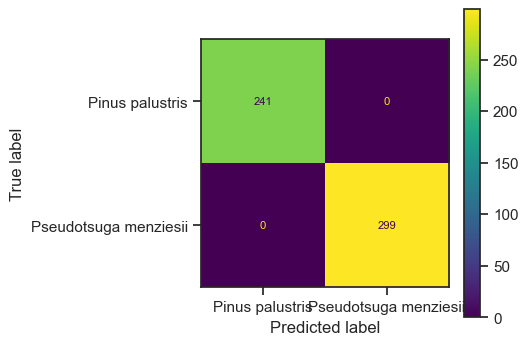

In [269]:
from remseno import *
from sklearn.ensemble import RandomForestClassifier
plt.rcParams["figure.figsize"] = (4,4)
#RandomForestClassifier(max_depth=20, random_state=0) #
clf = RandomForestClassifier(max_depth=20, random_state=0)#svm.LinearSVC(multi_class="crammer_singer", class_weight='balanced')
test_percent = 30

X = training_df[masking_cols].values

X = np.nan_to_num(X)
min_x = X.min(axis=0)
max_x = X.max(axis=0)
mean_x = X.mean(axis=0)
std_x = X.std(axis=0)
X = (X - min_x) / (max_x - min_x) #(X-mean_x)/std_x #
y = training_df['species']
# Train model
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_percent/100,
                                                    random_state=18)
# Get the pixels from the orthomosaic
clf = clf.fit(X_train, y_train)
clf.score(X_test, y_test)
test_score = clf.score(X_test, y_test)
y_pred = clf.predict(X_test)
print(test_score)


# Also do a decision tree classifier
pred = clf.predict(X_test)
cm = confusion_matrix(y_test, pred, labels=clf.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=clf.classes_)
disp.plot()
plt.show()

In [261]:
valid_df = pd.read_csv(f'{data_dir}training_pixels_neon_validation_nn.csv')


0.9125


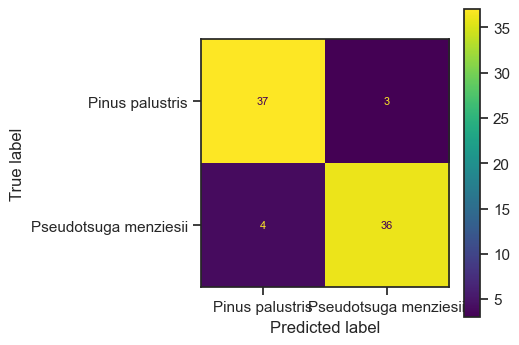

In [271]:
X = valid_df[masking_cols].values

X = np.nan_to_num(X)
min_x = X.min(axis=0)
max_x = X.max(axis=0)
mean_x = X.mean(axis=0)
std_x = X.std(axis=0)

X = (X - min_x) / (max_x - min_x)
#X = (X-mean_x)/std_x 
y = valid_df['species']

test_score = clf.score(X, y)
y_pred = clf.predict(X)
print(clf.score(X, y))

# Also do a decision tree classifier
pred = clf.predict(X)
cm = confusion_matrix(y, pred, labels=clf.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=clf.classes_)
disp.plot()
plt.show()


In [259]:
from sklearn.metrics import accuracy_score
accuracy_score(y, y_pred)

0.5196850393700787

In [266]:
species = valid_df['species'].value_counts()[valid_df['species'].value_counts().values >=20].keys()
species = ['Pseudotsuga menziesii', 'Pinus palustris']

In [267]:
valid_df = valid_df[valid_df['species'].isin(species)]

In [117]:
valid_df['species'].value_counts()

species
Pseudotsuga menziesii    40
Pinus palustris          40
Acer rubrum              25
Quercus stellata         22
Acer saccharum           17
                         ..
Prunus avium              1
Asimina triloba           1
Quercus falcata           1
Quercus margaretta        1
Acer circinatum           1
Name: count, Length: 153, dtype: int64

0.7692307692307693


/Users/ariane/opt/miniconda3/envs/rhm/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


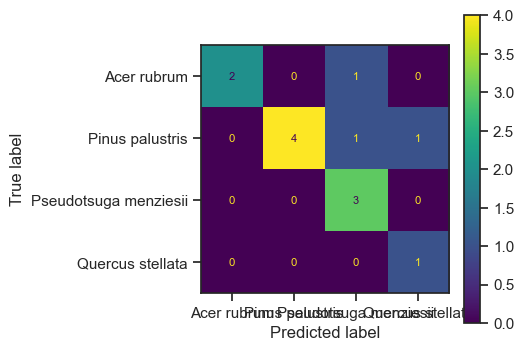

In [128]:
from remseno import *
from sklearn.ensemble import RandomForestClassifier
plt.rcParams["figure.figsize"] = (4,4)

valid_df = valid_df[valid_df['species'].isin(set(train_df['species'].values))]
valid_df = valid_df[valid_df['species'].isin(species)]

clf = svm.LinearSVC(multi_class="crammer_singer", class_weight='balanced')
test_percent = 10

X = valid_df[masking_cols].values

X = np.nan_to_num(X)
min_x = X.min(axis=0)
max_x = X.max(axis=0)
mean_x = X.mean(axis=0)
std_x = X.std(axis=0)
X = (X - mean_x) / std_x
y = valid_df['species']
# Train model
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_percent/100,
                                                    random_state=18)
# Get the pixels from the orthomosaic
clf = clf.fit(X_train, y_train)
clf.score(X_test, y_test)
test_score = clf.score(X_test, y_test)
y_pred = clf.predict(X_test)
print(test_score)


# Also do a decision tree classifier
pred = clf.predict(X_test)
cm = confusion_matrix(y_test, pred, labels=clf.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=clf.classes_)
disp.plot()
plt.show()


0.31257208765859285


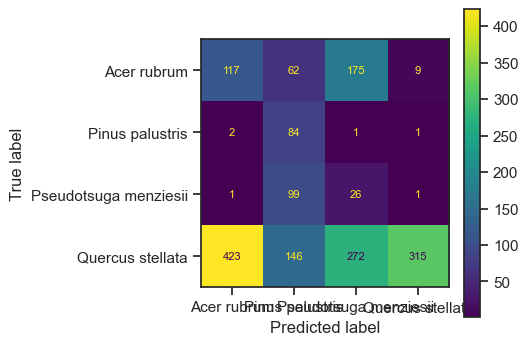

In [129]:
training_sub_df = training_df[training_df.species.isin(species)]
X = training_sub_df[masking_cols].values

X = np.nan_to_num(X)
min_x = X.min(axis=0)
max_x = X.max(axis=0)
mean_x = X.mean(axis=0)
std_x = X.std(axis=0)
X = (X - mean_x) / std_x
y = training_sub_df['species']

test_score = clf.score(X, y)
y_pred = clf.predict(X)
print(clf.score(X, y))

# Also do a decision tree classifier
pred = clf.predict(X)
cm = confusion_matrix(y, pred, labels=clf.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=clf.classes_)
disp.plot()
plt.show()


In [ ]:
clf.score(X_test, y_test)


In [ ]:
def mask_values(index, lower_bound, upper_bound):
    """
    Mask the image based on the index passed (for example NDVI).
    Make a multiplier i.e. 0 and 1s where it is above the threshold otherwise have nothing.

    :param index:
    :param index_cutoff:
    :return:
    """
    # Convert pixels to 0 if we have a mask, not sure if this is the best way to do it...
    mask1 = 1.0*(index < upper_bound)
    mask2 = 1.0*(index > lower_bound)
    
    return mask1*mask2


In [ ]:
from remseno import *


clf = svm.LinearSVC(multi_class="crammer_singer", class_weight='balanced')
test_percent = 25
bands = [1, 2, 3, 4, 5, 6, 7, 8]
masking_cols = [f'band_{i}' for i in bands] + ['nitian', 'ndvi', 'sr', 'tvi', 'gi', 'gndvi', 'pri', 'osavi', 'tcari', 'redge', 'redge2',
            'siredge', 'normg', 'schl', 'schlcar']

train_df = pd.DataFrame()# Get a random sample which is even between each species
for species in set(training_df['species'].values):
    s_df = training_df[training_df['species'] == species]
    if len(s_df) > 500:
        train_df = pd.concat([train_df, s_df.sample(min(500, len(s_df)))])
    
X = train_df[masking_cols].values

X = np.nan_to_num(X)
min_x = X.min(axis=0)
max_x = X.max(axis=0)
mean_x = X.mean(axis=0)
std_x = X.std(axis=0)
X = (X - min_x) / (max_x - min_x)
y = train_df['species']
# Train model
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_percent/100,
                                                    random_state=18)


In [ ]:
# Get the pixels from the orthomosaic
clf = clf.fit(X_train, y_train)
clf.score(X_test, y_test)
test_score = clf.score(X_test, y_test)
y_pred = clf.predict(X_test)
print(test_score, y_pred)



In [ ]:
plt.rcParams["figure.figsize"] = (20,20)

# Also do a decision tree classifier
pred = clf.predict(X_test)
cm = confusion_matrix(y_test, pred, labels=clf.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=clf.classes_)
disp.plot()
plt.show()


In [ ]:
# Also do a decision tree classifier
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
pred = clf.predict(X_test)
cm = confusion_matrix(y_test, pred, labels=clf.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=clf.classes_, normalize="true")
disp.plot()
plt.show()

In [ ]:
# We can make a PCA of the normalised values
from sklearn.decomposition import PCA
import seaborn as sns

X = train_df[masking_cols].values
X = np.nan_to_num(X)
pca = PCA(n_components=2)
min_x = X.min(axis=0)
max_x = X.max(axis=0)
mean_x = X.mean(axis=0)
std_x = X.std(axis=0)
X = (X - mean_x)/std_x
X_std = (X - min_x) / (max_x - min_x)

pca.fit(X_std)
pc_X = pca.transform(X_std)
train_df['PC1'] = pc_X[:, 0]
train_df['PC2'] = pc_X[:, 1]

ax = sns.scatterplot(data=train_df, x='PC1', y='PC2', hue='species', alpha=0.5)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))


In [36]:
masks = []
for i, col in enumerate(masking_cols):
    # Now we want to build a total mask...
    mean_v = np.nanmedian(ind_df[col].values)
    std_v = np.nanstd(ind_df[col].values)
    lower_bound = mean_v - std_v #np.min(ind_df[col].values) # - std_v #mean_v - std_v
    upper_bound = mean_v + std_v #np.max(ind_df[col].values) # + std_v #mean_v + std_v
    print(col, lower_bound, upper_bound)
    print(mask_values(info_cols[i], lower_bound, upper_bound).shape)
    print(mask_values(info_cols[i], lower_bound, upper_bound) > 0)
    masks.append(mask_values(info_cols[i], lower_bound, upper_bound))


band_1 98.82167071410194 577.178329285898
(173, 186)
[[False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]
 ...
 [False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]]
band_2 94.01112685459668 647.9888731454033
(173, 186)
[[False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]
 ...
 [False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]]
band_3 206.90206800923443 817.0979319907656
(173, 186)
[[False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]
 ...
 [False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]]
band_4 222.07599032456505 933.924009675435
(17

In [14]:
nitian, ndvi, sr, tvi, gi, gndvi, pri, osavi, tcari, redge, redge2, siredge, normg, schl, schlcar = get_all_planetscope(img)
info_cols = image_bands + [nitian, ndvi, sr, tvi, gi, gndvi, pri, osavi, tcari, redge, redge2, siredge, normg, schl, schlcar]
masks = []
for i, col in enumerate(masking_cols):
    # Now we want to build a total mask...
    mean_v = np.nanmedian(ind_df[col].values)
    std_v = np.nanstd(ind_df[col].values)
    lower_bound = mean_v - std_v #np.min(ind_df[col].values) # - std_v #mean_v - std_v
    upper_bound = mean_v + std_v #np.max(ind_df[col].values) # + std_v #mean_v + std_v
    print(col, lower_bound, upper_bound)
    
    masks.append(mask_values(info_cols[i], lower_bound, upper_bound))

nitian 0.6352743024010896 0.8087104369938367
ndvi -8.697481939385218 10.092980331668178
sr -0.23546292316217698 10.534699510919566
tvi -28401.338101700334 10513.338101700334
gi -29763.007332385714 30035.007332385714
gndvi -8.005691229816037 9.275138805915248
pri 13.16702801961626 105.11481479881192
osavi -8.555935400224884 9.922698243966765
tcari -857567147.4142284 858446117.4142284
redge 1915.9757262938638 6616.548545550797
redge2 -69.71968875952325 1637.681319454967
siredge 0.30652800544813896 0.704107695104246
normg 0.34610192918778976 0.44809106825029726
schl -8.891274621743747 9.939994023847046
schlcar -33.217844699744504 85.12026437447676


In [12]:
ind_df[col].values

array([5.52995392e-02, 3.87811634e-02, 2.00000000e-01, 1.92575406e-01,
       7.04451613e+01, 2.16867470e-02, 7.71470160e-02, 8.23045267e-02,
       6.66666667e-02, 1.15311909e-01,            nan,            nan,
                  nan,            nan,            nan, 5.52995392e-02,
       3.87811634e-02, 2.00000000e-01, 1.92575406e-01, 7.04451613e+01,
       2.16867470e-02, 7.71470160e-02, 8.23045267e-02, 6.66666667e-02,
       1.15311909e-01,            nan,            nan,            nan,
                  nan,            nan, 5.52995392e-02, 3.87811634e-02,
       2.00000000e-01, 1.92575406e-01, 7.04451613e+01, 2.16867470e-02,
       7.71470160e-02, 8.23045267e-02, 6.66666667e-02, 1.15311909e-01,
                  nan,            nan,            nan,            nan,
                  nan, 5.05792730e+01, 4.27863696e+01, 4.15174825e+01,
       4.29631336e+01, 4.64793741e+01, 3.09866412e+01, 3.08763671e+01,
       3.23187469e+01, 2.64314845e+01, 1.83776641e+01, 1.71803671e+01,
      